In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/ac-data/AC_Data.csv
/kaggle/input/temperature/Temperature.csv


In [2]:
import seaborn as sns

import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rcParams['figure.figsize'] = (8, 6)
mpl.rcParams['axes.grid'] = False

In [3]:
data= pd.read_csv('../input/ac-data/AC_Data.csv')

In [4]:
pd.set_option('display.max_rows', 50000000)
pd.set_option('display.max_columns', 50000000)


In [5]:
data.head(100)

,0,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18
0,2019-08-01 00:00:00,7.518632,8.788315,0.000000,0.000000,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981
1,2019-08-01 00:01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2019-08-01 00:02:00,7.426114,8.940615,0.000000,0.000000,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500
3,2019-08-01 00:03:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2019-08-01 00:04:00,7.052986,9.161103,0.000000,0.000000,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475
5,2019-08-01 00:05:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,2019-08-01 00:06:00,6.665446,9.065626,0.000000,0.000000,2.575639,3.772891,2.596200,5.805132,3.553778,1.878356,2.737645,2.510972,3.090007,2.666604,4.607439,3.062610,3.063953,6.127366
7,2019-08-01 00:07:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2019-08-01 00:08:00,6.674838,9.096130,0.000000,0.000000,2.021472,3.155697,2.845417,6.315060,3.042244,1.914650,2.452500,2.171791,3.097202,2.710572,5.332696,2.640150,2.864680,5.662474
9,2019-08-01 00:09:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
## Data is captured in evry 1 minute at some days at 2 mins as well

In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87840 entries, 0 to 87839
Data columns (total 19 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       87840 non-null  object 
 1   AC 1    43708 non-null  float64
 2   AC 2    43711 non-null  float64
 3   AC 3    43713 non-null  float64
 4   AC 4    43704 non-null  float64
 5   AC 5    43716 non-null  float64
 6   AC 6    43717 non-null  float64
 7   AC 7    43679 non-null  float64
 8   AC 8    43704 non-null  float64
 9   AC 9    43654 non-null  float64
 10  AC 10   43690 non-null  float64
 11  AC 11   43670 non-null  float64
 12  AC 12   43713 non-null  float64
 13  AC 13   43719 non-null  float64
 14  AC 14   43696 non-null  float64
 15  AC 15   43715 non-null  float64
 16  AC 16   43710 non-null  float64
 17  AC 17   43714 non-null  float64
 18  AC 18   43723 non-null  float64
dtypes: float64(18), object(1)
memory usage: 12.7+ MB


In [8]:
data.describe()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18
count,43708.000000,43711.000000,43713.000000,43704.000000,43716.000000,43717.000000,43679.000000,43704.000000,43654.000000,43690.000000,43670.000000,43713.000000,43719.000000,43696.000000,43715.000000,43710.000000,43714.000000,43723.000000
mean,2.379368,3.868892,2.568411,2.395158,1.421699,2.518138,2.980883,2.548711,3.184382,1.538344,2.406141,2.699639,4.279893,2.917122,4.046283,2.800050,4.218979,6.462676
std,2.276782,2.545147,1.487508,1.797529,0.767218,1.655560,1.473498,1.504482,1.522291,0.685461,1.554481,1.436087,1.847168,1.454946,2.016898,1.606239,1.125491,2.319242
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,2.123263,1.706508,1.258299,0.970744,1.543779,2.190803,1.766230,2.294635,1.117139,1.591748,1.949729,3.260674,1.852981,3.023501,1.877626,3.752478,4.013579
50%,2.094330,3.791752,2.486992,2.308961,1.380183,2.665063,3.005071,2.608551,3.082134,1.504554,2.351361,2.727152,4.217381,2.787084,4.001279,2.673698,4.611434,7.131194
75%,3.661752,5.460892,3.441527,3.476123,1.870234,3.616988,3.897857,3.496358,4.096374,1.963707,3.254937,3.566744,5.379832,3.824467,5.260193,3.695294,4.958306,8.314639
max,11.194789,11.147141,8.430909,9.879500,5.495358,9.929291,9.356776,9.331506,10.026747,4.625030,10.363151,9.887306,9.796393,9.054969,10.349998,10.654430,5.950261,11.040031


In [9]:
data.shape

(87840, 19)

In [10]:
## count of NAN rows
len(data[data.isna().any(axis=1)])

53198

In [11]:
data.head(5)

,0,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18
0,2019-08-01 00:00:00,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981
1,2019-08-01 00:01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2019-08-01 00:02:00,7.426114,8.940615,0.0,0.0,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500
3,2019-08-01 00:03:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2019-08-01 00:04:00,7.052986,9.161103,0.0,0.0,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475


In [12]:
data['date_time'] = pd.to_datetime(data['0'])


In [13]:
data['dates'] = pd.to_datetime(data['date_time']).dt.date
data['time'] = pd.to_datetime(data['date_time']).dt.time

In [14]:
data['day']=pd.to_datetime(data['date_time']).dt.day_name()


In [15]:
data['weekend'] = (data['date_time'].dt.weekday > 4) * 1


In [16]:
data['year'] = data['date_time'].dt.year
data['month'] = data['date_time'].dt.month

In [17]:
data['day_of_week'] = data['date_time'].dt.dayofweek

In [18]:
# Monday=0 , Sunday =6

In [19]:
data.head()

,0,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,date_time,dates,time,day,weekend,year,month,day_of_week
0,2019-08-01 00:00:00,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981,2019-08-01 00:00:00,2019-08-01,00:00:00,Thursday,0,2019,8,3
1,2019-08-01 00:01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-08-01 00:01:00,2019-08-01,00:01:00,Thursday,0,2019,8,3
2,2019-08-01 00:02:00,7.426114,8.940615,0.0,0.0,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,2019-08-01 00:02:00,2019-08-01,00:02:00,Thursday,0,2019,8,3
3,2019-08-01 00:03:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-08-01 00:03:00,2019-08-01,00:03:00,Thursday,0,2019,8,3
4,2019-08-01 00:04:00,7.052986,9.161103,0.0,0.0,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475,2019-08-01 00:04:00,2019-08-01,00:04:00,Thursday,0,2019,8,3


In [20]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87840 entries, 0 to 87839
Data columns (total 27 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   0            87840 non-null  object        
 1   AC 1         43708 non-null  float64       
 2   AC 2         43711 non-null  float64       
 3   AC 3         43713 non-null  float64       
 4   AC 4         43704 non-null  float64       
 5   AC 5         43716 non-null  float64       
 6   AC 6         43717 non-null  float64       
 7   AC 7         43679 non-null  float64       
 8   AC 8         43704 non-null  float64       
 9   AC 9         43654 non-null  float64       
 10  AC 10        43690 non-null  float64       
 11  AC 11        43670 non-null  float64       
 12  AC 12        43713 non-null  float64       
 13  AC 13        43719 non-null  float64       
 14  AC 14        43696 non-null  float64       
 15  AC 15        43715 non-null  float64       
 16  AC 1

In [21]:
data.nunique()

0              87840
AC 1           29689
AC 2           37523
AC 3           38867
AC 4           34097
AC 5           39466
AC 6           34641
AC 7           39684
AC 8           37018
AC 9           40817
AC 10          41393
AC 11          36656
AC 12          38771
AC 13          41336
AC 14          41897
AC 15          39635
AC 16          39163
AC 17          42531
AC 18          42209
date_time      87840
dates             61
time            1440
day                7
weekend            2
year               1
month              2
day_of_week        7
dtype: int64

In [22]:
data.year.unique(),data.month.unique()

(array([2019]), array([8, 9]))

In [23]:
# 2019-08-01    - 2019-09-30
# August       -    Spetember

In [24]:
# Calculation of date time records
#31*1440 + 30*1440 = 87840 
# is equal to the no of records we have 
#

In [25]:
# Mkaing a copy of data 
data_copy = data.copy()

In [26]:
data.set_index('date_time',inplace=True)

In [27]:
data.drop(['0'], axis = 1,inplace=True)


In [28]:
data.head()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,dates,time,day,weekend,year,month,day_of_week
date_time,,,,,,,,,,,,,,,,,,,,,,,,,
2019-08-01 00:00:00,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981,2019-08-01,00:00:00,Thursday,0,2019,8,3
2019-08-01 00:01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-08-01,00:01:00,Thursday,0,2019,8,3
2019-08-01 00:02:00,7.426114,8.940615,0.0,0.0,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,2019-08-01,00:02:00,Thursday,0,2019,8,3
2019-08-01 00:03:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-08-01,00:03:00,Thursday,0,2019,8,3
2019-08-01 00:04:00,7.052986,9.161103,0.0,0.0,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475,2019-08-01,00:04:00,Thursday,0,2019,8,3


In [29]:
import math

def add_week_of_month(df):
    df['week_in_month'] = pd.to_numeric(df.index.day/7)
    df['week_in_month'] = df['week_in_month'].apply(lambda x: math.ceil(x))
    return df

In [30]:
data= add_week_of_month(data)

In [31]:
data.head()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,dates,time,day,weekend,year,month,day_of_week,week_in_month
date_time,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-08-01 00:00:00,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981,2019-08-01,00:00:00,Thursday,0,2019,8,3,1
2019-08-01 00:01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-08-01,00:01:00,Thursday,0,2019,8,3,1
2019-08-01 00:02:00,7.426114,8.940615,0.0,0.0,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,2019-08-01,00:02:00,Thursday,0,2019,8,3,1
2019-08-01 00:03:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-08-01,00:03:00,Thursday,0,2019,8,3,1
2019-08-01 00:04:00,7.052986,9.161103,0.0,0.0,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475,2019-08-01,00:04:00,Thursday,0,2019,8,3,1


In [32]:
ac_1_data = data['AC 1']
ac_1_data.head()

date_time
2019-08-01 00:00:00    7.518632
2019-08-01 00:01:00         NaN
2019-08-01 00:02:00    7.426114
2019-08-01 00:03:00         NaN
2019-08-01 00:04:00    7.052986
Name: AC 1, dtype: float64

<AxesSubplot:xlabel='date_time'>

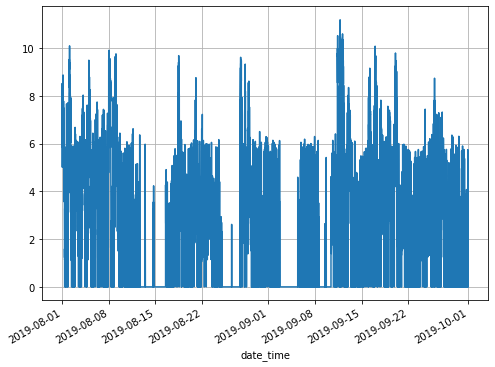

In [33]:
ac_1_data.dropna().plot(grid=True, )


In [34]:
ac_1_data=  ac_1_data.loc['2019-Sep'] 

<AxesSubplot:xlabel='date_time'>

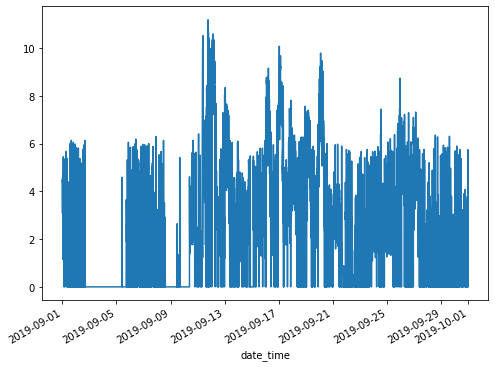

In [35]:
ac_1_data.dropna().plot( )


In [36]:
ac_1_data.isna().sum()

21655

In [37]:
## Percent of Missing values for month of august for ac 1 data 
(ac_1_data.shape -ac_1_data.isna().sum())/ ac_1_data.shape

array([0.49872685])

In [38]:
(len(data) - data.isna().sum() )/ len(data)

AC 1             0.497587
AC 2             0.497621
AC 3             0.497643
AC 4             0.497541
AC 5             0.497678
AC 6             0.497689
AC 7             0.497256
AC 8             0.497541
AC 9             0.496972
AC 10            0.497382
AC 11            0.497154
AC 12            0.497643
AC 13            0.497712
AC 14            0.497450
AC 15            0.497666
AC 16            0.497609
AC 17            0.497655
AC 18            0.497757
dates            1.000000
time             1.000000
day              1.000000
weekend          1.000000
year             1.000000
month            1.000000
day_of_week      1.000000
week_in_month    1.000000
dtype: float64

In [39]:
## Approx all column has 50% of Missing data we will handle them first before doing analysis

In [40]:
## Since we know our data is in the interval of 1 minutes so we will fill our values with the next immediate value present
## But before doing this thing we will first chek the co- realtion of the data

In [41]:
cord= data.copy()

In [42]:
cord=cord.dropna()


In [43]:
cord.shape

(34642, 26)

<AxesSubplot:xlabel='Lag', ylabel='Autocorrelation'>

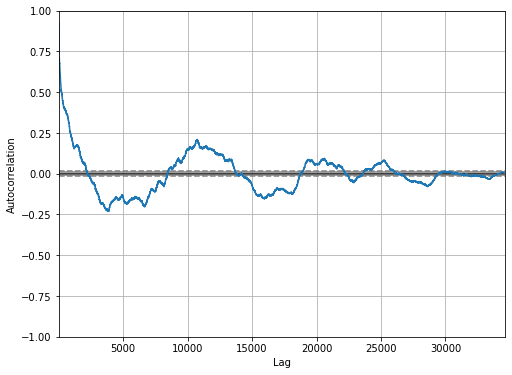

In [44]:
pd.plotting.autocorrelation_plot(cord['AC 2'])


<AxesSubplot:xlabel='Lag', ylabel='Autocorrelation'>

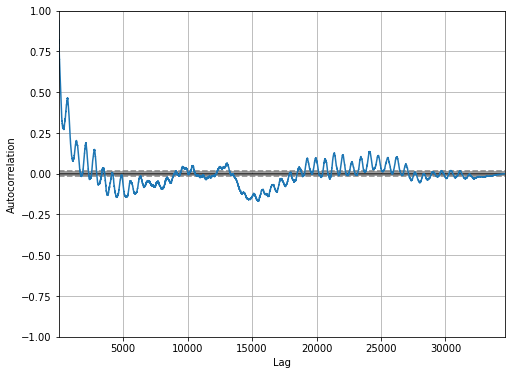

In [45]:
pd.plotting.autocorrelation_plot(cord['AC 1'])


<AxesSubplot:xlabel='Lag', ylabel='Autocorrelation'>

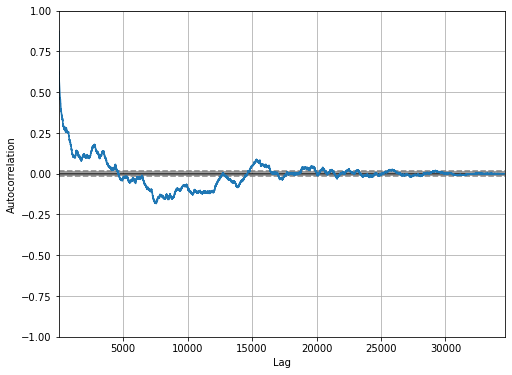

In [46]:
pd.plotting.autocorrelation_plot(cord['AC 3'])


<AxesSubplot:xlabel='Lag', ylabel='Autocorrelation'>

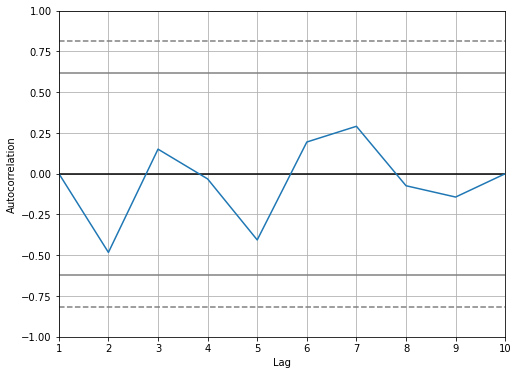

In [47]:
pd.plotting.autocorrelation_plot(data['AC 1'].dropna().resample("W").mean())


<AxesSubplot:xlabel='Lag', ylabel='Autocorrelation'>

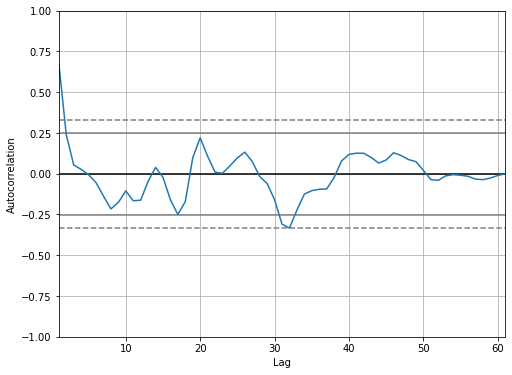

In [48]:
pd.plotting.autocorrelation_plot(data['AC 1'].dropna().resample("D").mean())


<AxesSubplot:xlabel='Lag', ylabel='Autocorrelation'>

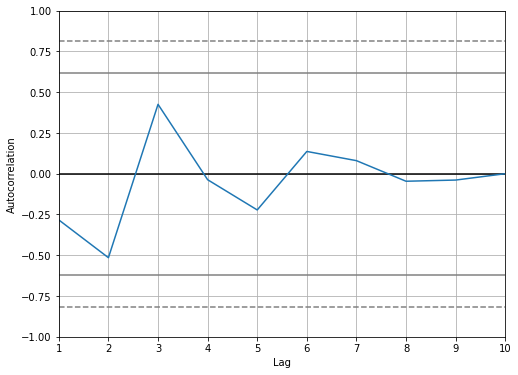

In [49]:
pd.plotting.autocorrelation_plot(data['AC 2'].dropna().resample("W").mean())


In [50]:
column_name=['AC 1', 'AC 2', 'AC 3', 'AC 4', 'AC 5', 'AC 6', 'AC 7', 'AC 8',
       'AC 9', 'AC 10', 'AC 11', 'AC 12', 'AC 13', 'AC 14', 'AC 15', 'AC 16',
       'AC 17', 'AC 18']

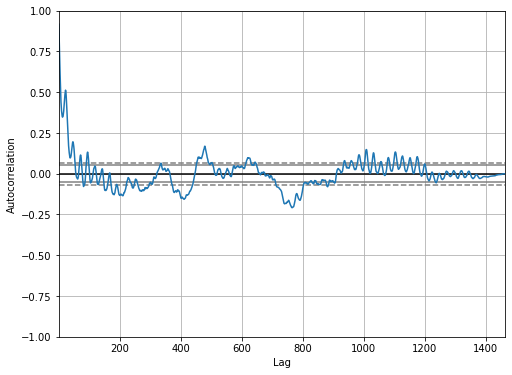

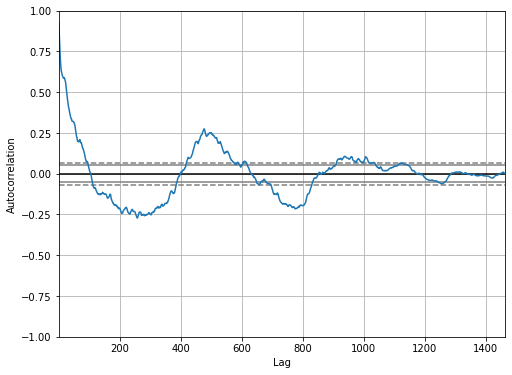

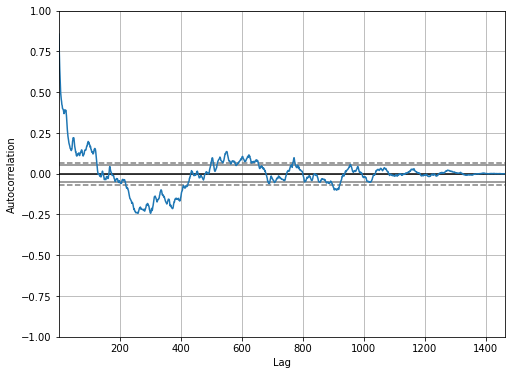

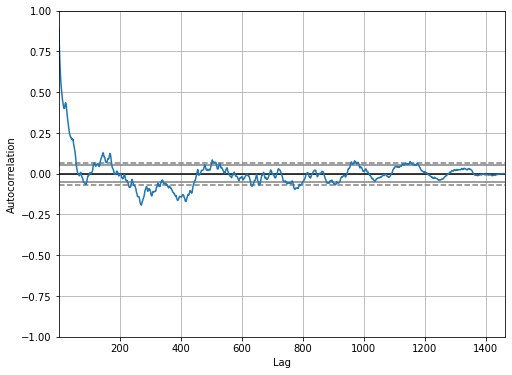

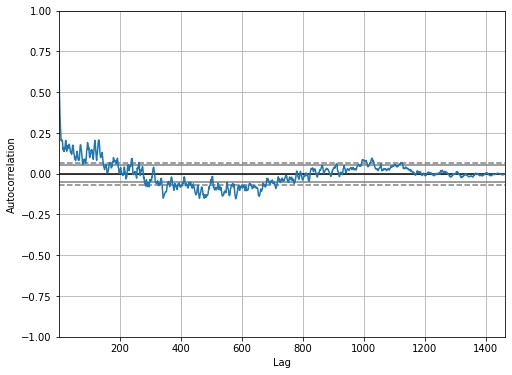

...

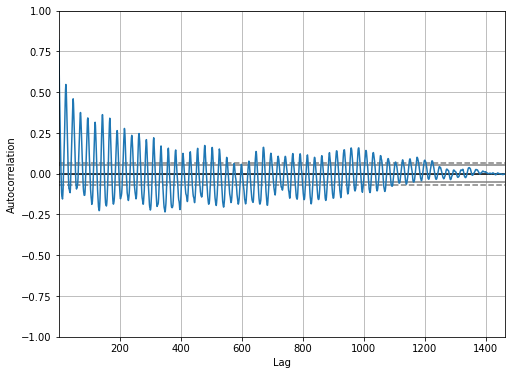

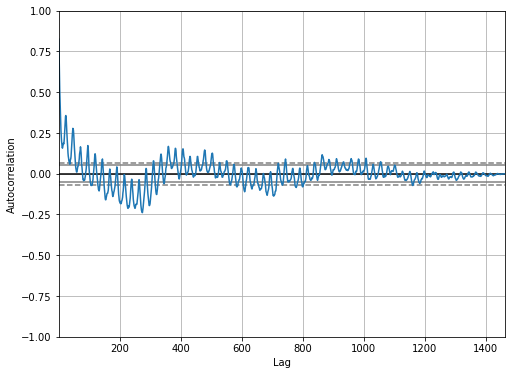

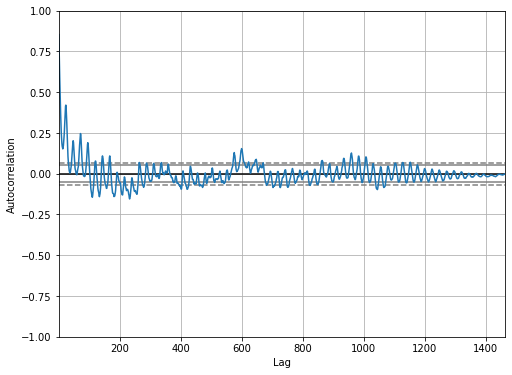

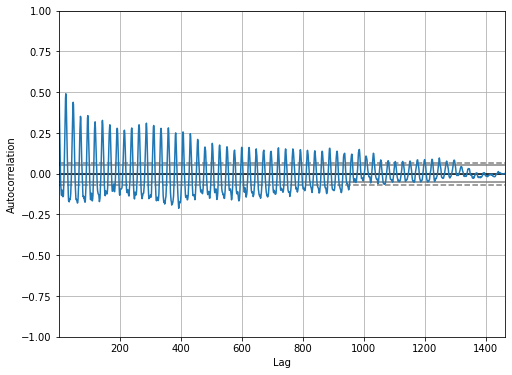

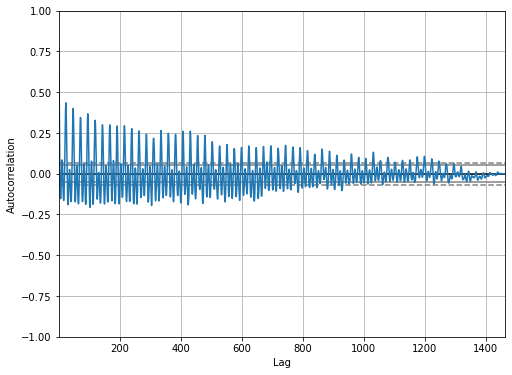

In [51]:
for value in column_name:
    pd.plotting.autocorrelation_plot(data[value].dropna().resample("H").mean())

    plt.show()


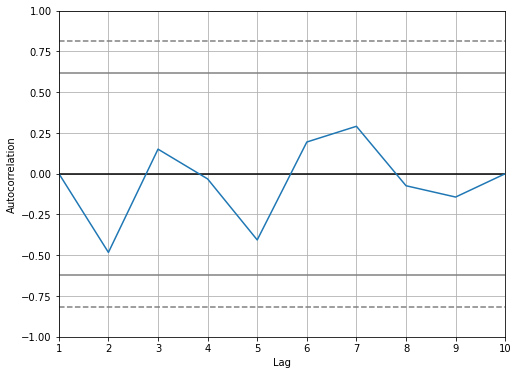

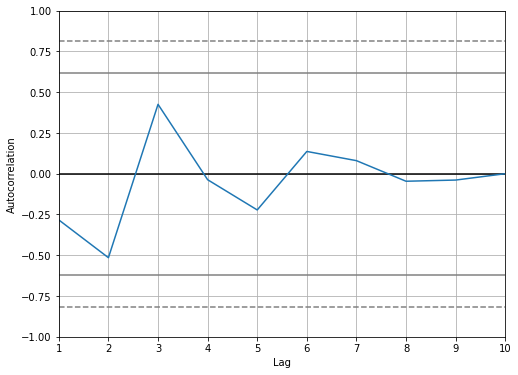

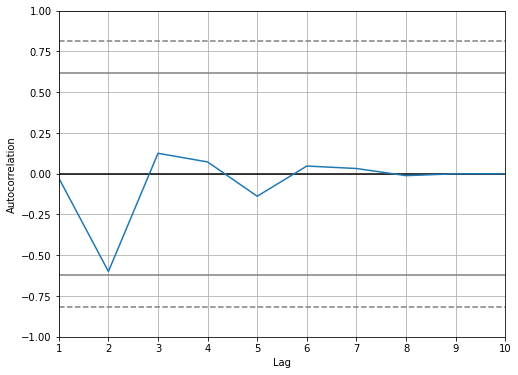

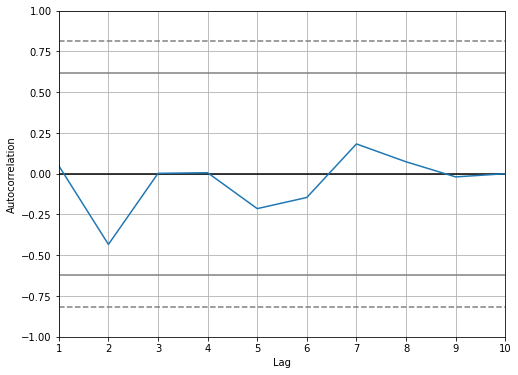

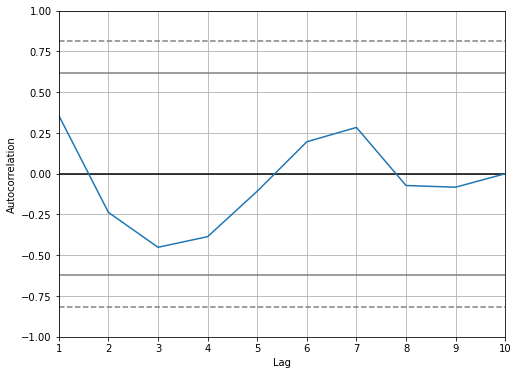

...

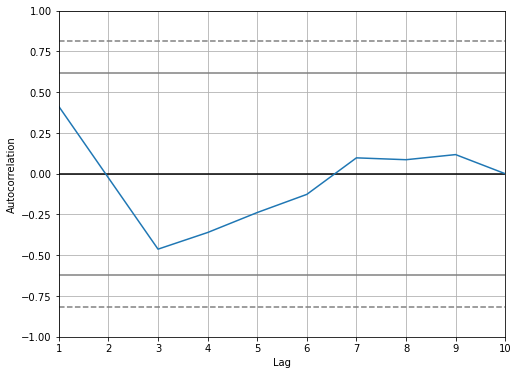

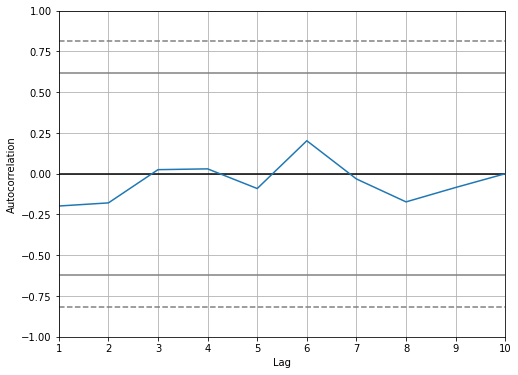

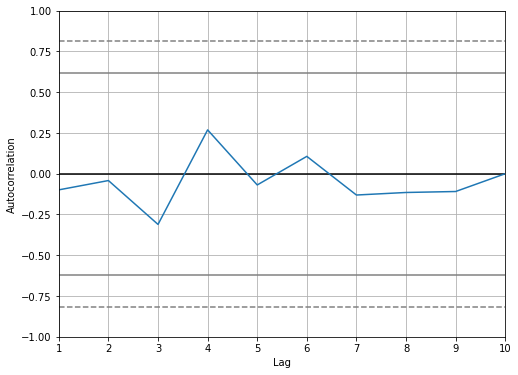

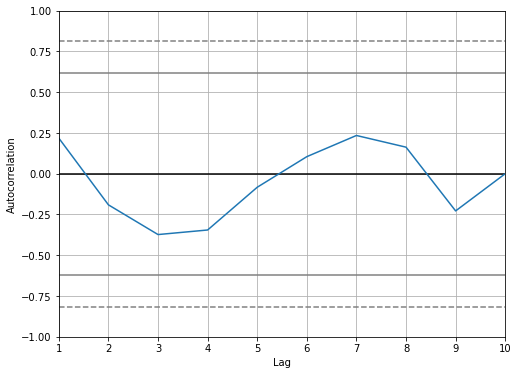

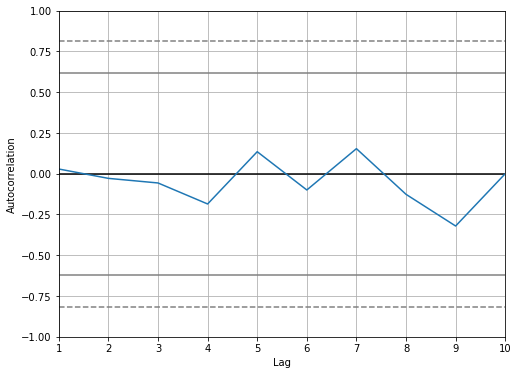

In [52]:
for value in column_name:
    pd.plotting.autocorrelation_plot(data[value].dropna().resample("W").mean())

    plt.show()


In [53]:
## We can see here there is weekly  auto co relation going on with AC 1 and AC 2

<AxesSubplot:xlabel='y(t)', ylabel='y(t + 1)'>

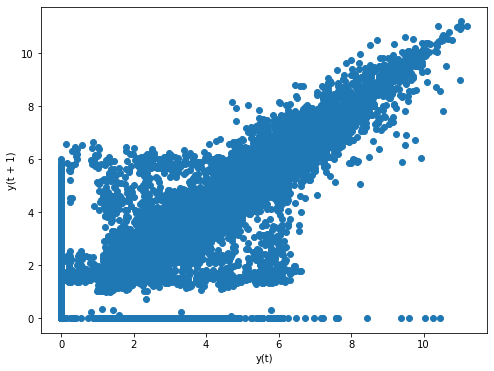

In [54]:
pd.plotting.lag_plot(data['AC 1'].dropna(),lag=1)


In [55]:
data_copy.head()

,0,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,date_time,dates,time,day,weekend,year,month,day_of_week
0,2019-08-01 00:00:00,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981,2019-08-01 00:00:00,2019-08-01,00:00:00,Thursday,0,2019,8,3
1,2019-08-01 00:01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-08-01 00:01:00,2019-08-01,00:01:00,Thursday,0,2019,8,3
2,2019-08-01 00:02:00,7.426114,8.940615,0.0,0.0,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,2019-08-01 00:02:00,2019-08-01,00:02:00,Thursday,0,2019,8,3
3,2019-08-01 00:03:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-08-01 00:03:00,2019-08-01,00:03:00,Thursday,0,2019,8,3
4,2019-08-01 00:04:00,7.052986,9.161103,0.0,0.0,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475,2019-08-01 00:04:00,2019-08-01,00:04:00,Thursday,0,2019,8,3


In [56]:
data_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87840 entries, 0 to 87839
Data columns (total 27 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   0            87840 non-null  object        
 1   AC 1         43708 non-null  float64       
 2   AC 2         43711 non-null  float64       
 3   AC 3         43713 non-null  float64       
 4   AC 4         43704 non-null  float64       
 5   AC 5         43716 non-null  float64       
 6   AC 6         43717 non-null  float64       
 7   AC 7         43679 non-null  float64       
 8   AC 8         43704 non-null  float64       
 9   AC 9         43654 non-null  float64       
 10  AC 10        43690 non-null  float64       
 11  AC 11        43670 non-null  float64       
 12  AC 12        43713 non-null  float64       
 13  AC 13        43719 non-null  float64       
 14  AC 14        43696 non-null  float64       
 15  AC 15        43715 non-null  float64       
 16  AC 1

In [57]:
data_copy_1=data_copy.fillna(0)

In [58]:
import plotly.express as px
fig = px.line(data_copy_1, x=data_copy_1['date_time'], y=data_copy_1['AC 1'], title='AC 1 with Slider')

fig.update_xaxes(rangeslider_visible=True)
fig.show()

In [59]:
fig = px.line(data_copy_1, x=data_copy_1['date_time'], y='AC 1', title='AC 1 with Slider')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=1, label="1H", step="hour", stepmode="backward"),

            dict(step="all")
        ])
    )
)
fig.show()

In [60]:
ac_1_data= data['AC 1']

In [61]:
ac_1_data.dropna(inplace=True)

In [62]:
data.head()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,dates,time,day,weekend,year,month,day_of_week,week_in_month
date_time,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-08-01 00:00:00,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981,2019-08-01,00:00:00,Thursday,0,2019,8,3,1
2019-08-01 00:01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-08-01,00:01:00,Thursday,0,2019,8,3,1
2019-08-01 00:02:00,7.426114,8.940615,0.0,0.0,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,2019-08-01,00:02:00,Thursday,0,2019,8,3,1
2019-08-01 00:03:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-08-01,00:03:00,Thursday,0,2019,8,3,1
2019-08-01 00:04:00,7.052986,9.161103,0.0,0.0,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475,2019-08-01,00:04:00,Thursday,0,2019,8,3,1


<AxesSubplot:xlabel='date_time'>

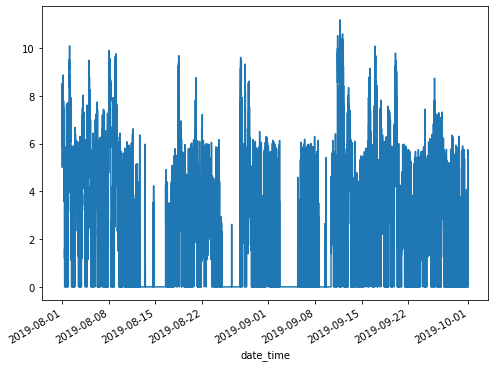

In [63]:
ac_1_data.plot()

In [64]:
fig = px.line(data_copy_1, x=data_copy_1['date_time'], y='AC 14', title='AC 1 with Slider')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=1, label="1H", step="hour", stepmode="backward"),

            dict(step="all")
        ])
    )
)
fig.show()

In [65]:
data_copy_1.columns

Index(['0', 'AC 1', 'AC 2', 'AC 3', 'AC 4', 'AC 5', 'AC 6', 'AC 7', 'AC 8',
       'AC 9', 'AC 10', 'AC 11', 'AC 12', 'AC 13', 'AC 14', 'AC 15', 'AC 16',
       'AC 17', 'AC 18', 'date_time', 'dates', 'time', 'day', 'weekend',
       'year', 'month', 'day_of_week'],
      dtype='object')

In [66]:
column_name=['AC 1', 'AC 2', 'AC 3', 'AC 4', 'AC 5', 'AC 6', 'AC 7', 'AC 8',
       'AC 9', 'AC 10', 'AC 11', 'AC 12', 'AC 13', 'AC 14', 'AC 15', 'AC 16',
       'AC 17', 'AC 18']

<AxesSubplot:xlabel='date_time'>

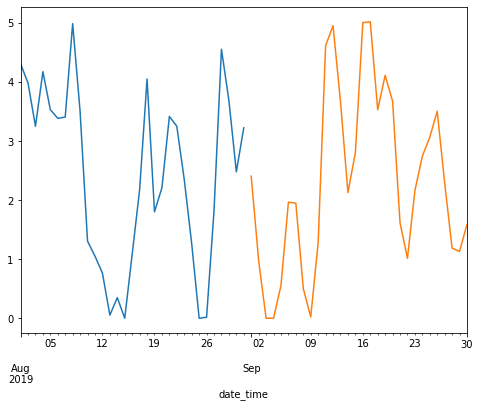

In [67]:
data.loc['2019-08-01':'2019-08-31']['AC 1'].dropna().resample("D").mean().plot()
data.loc['2019-09-01':'2019-09-30']['AC 1'].dropna().resample("D").mean().plot()

In [68]:
aug=data.loc['2019-08-01':'2019-08-31']['AC 1'].dropna().resample("D").mean()
sep=data.loc['2019-09-01':'2019-09-30']['AC 1'].dropna().resample("D").mean()

In [69]:
aug= pd.DataFrame(aug)
sep= pd.DataFrame(sep)

In [70]:
val=sep['AC 1'].tolist()

In [71]:
val.append(0)

In [72]:
aug['AC_1_Sep']= val

In [73]:
aug

,AC 1,AC_1_Sep
date_time,,
2019-08-01,4.311540,2.407889
2019-08-02,3.986638,0.975757
2019-08-03,3.253671,0.000000
2019-08-04,4.178977,0.000000
2019-08-05,3.535445,0.555595
2019-08-06,3.387992,1.968174
2019-08-07,3.409895,1.949436
2019-08-08,4.992748,0.503640
2019-08-09,3.505959,0.022197


<AxesSubplot:xlabel='date_time'>

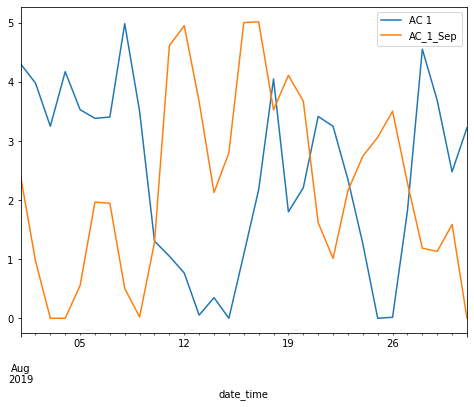

In [74]:
aug.plot()

In [75]:
aug=data.loc['2019-08-01':'2019-08-31']['AC 1'].dropna().resample("D").mean()


In [76]:
aug= pd.DataFrame(aug)


In [77]:
aug.drop(['AC 1'] ,axis=1,inplace=True)

In [78]:
for value in column_name:
    august=data.loc['2019-08-01':'2019-08-31'][value].dropna().resample("D").mean()
    august= pd.DataFrame(august)
    aug[value]=august[value]

    

In [79]:
## plotting ac usage of all Ac in the month of August

<AxesSubplot:xlabel='date_time'>

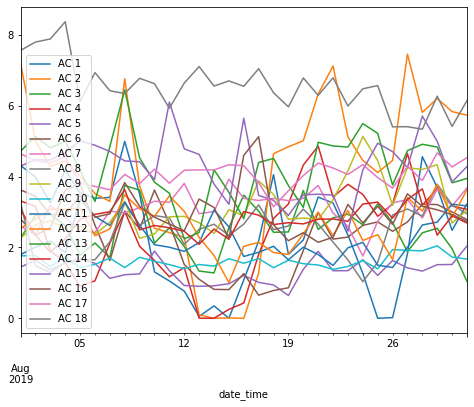

In [80]:
aug.plot()

In [81]:
## Now basically you can see similar usage pattern between ac's

/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



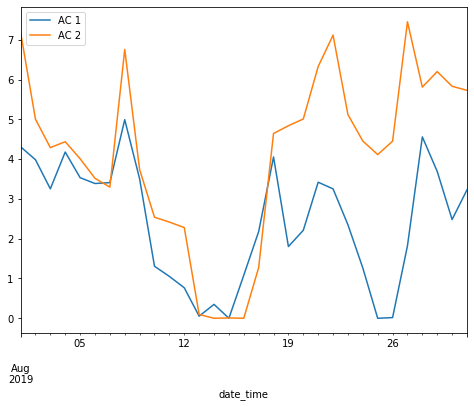

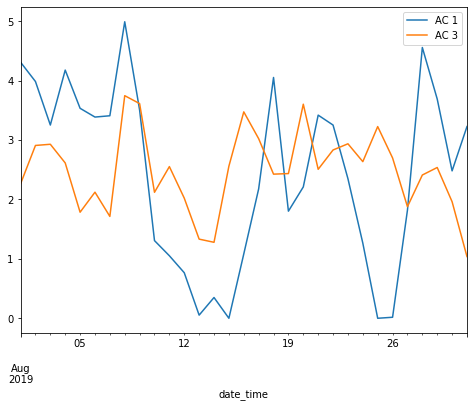

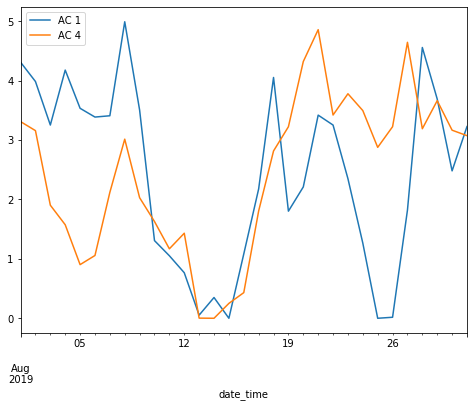

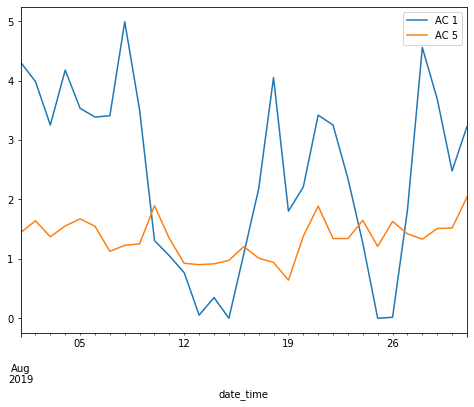

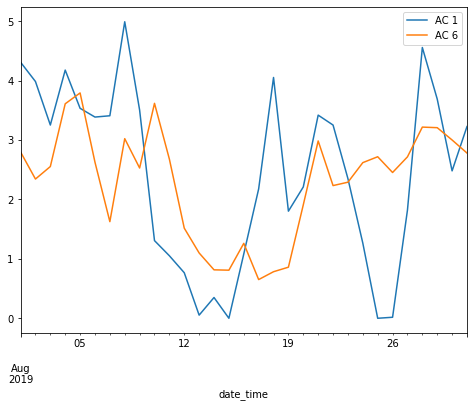

...

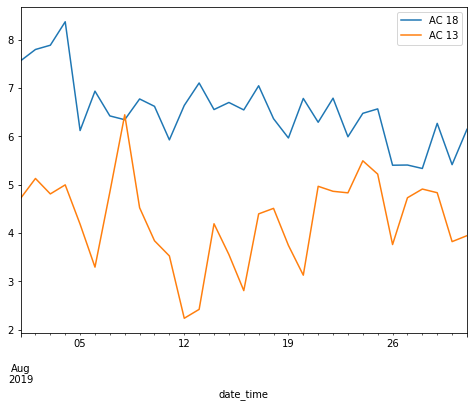

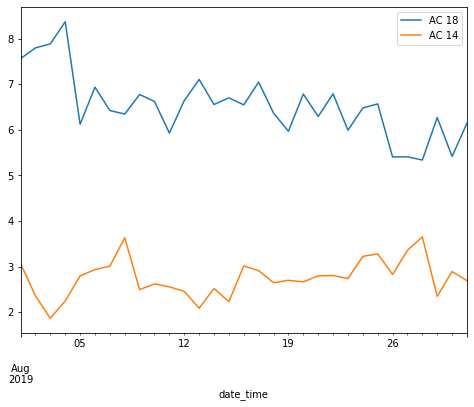

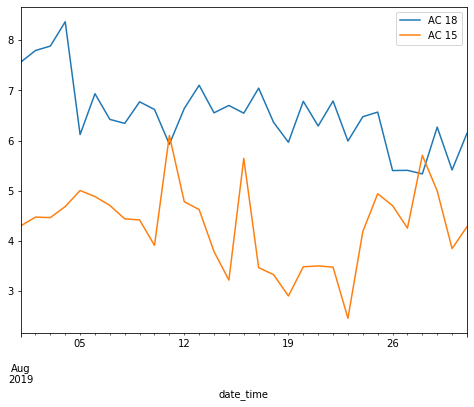

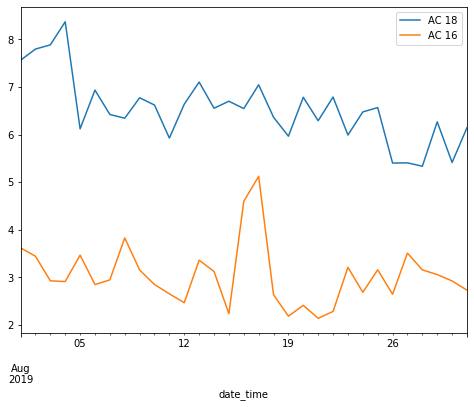

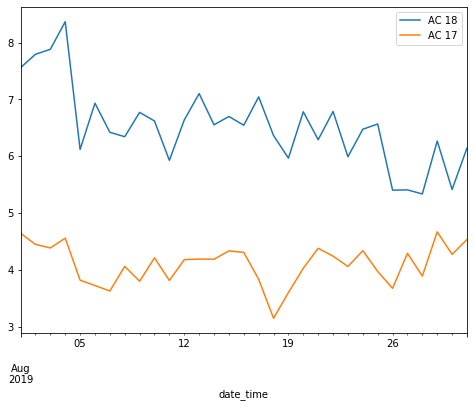

In [82]:
from itertools import permutations
perm = permutations(column_name, 2)
 
# Print the obtained permutations
for combo in list(perm):
    aug[[combo[0],combo[1] ]].plot()


In [83]:
### We will club similar kind of pattern Ac 's together'

<AxesSubplot:xlabel='date_time'>

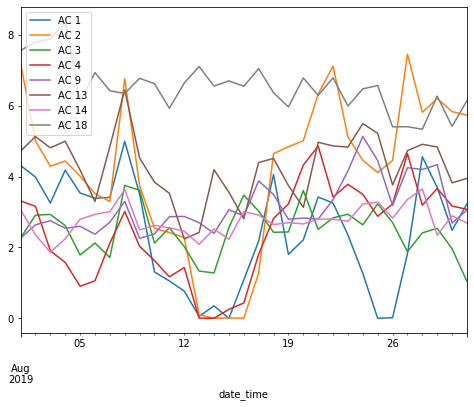

In [84]:
aug[['AC 1','AC 2','AC 3','AC 4','AC 9','AC 13','AC 14','AC 18']].plot()

<AxesSubplot:xlabel='date_time'>

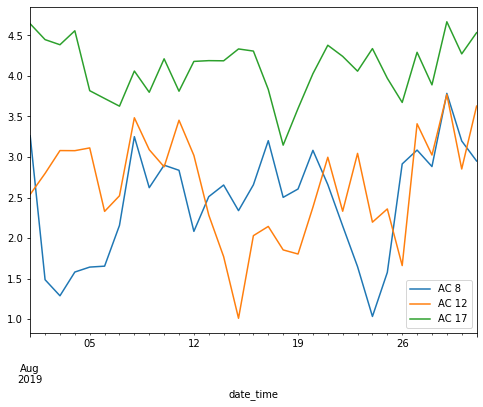

In [85]:
aug[['AC 8','AC 12','AC 17']].plot()

<AxesSubplot:xlabel='date_time'>

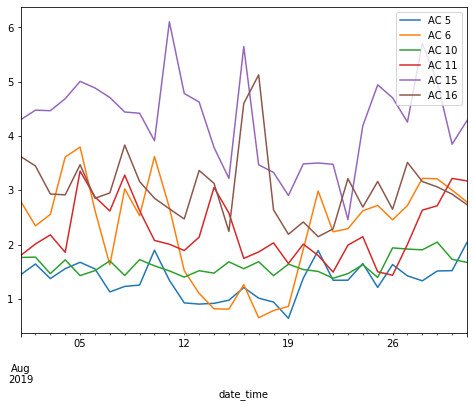

In [86]:
aug[['AC 5','AC 6','AC 10','AC 11','AC 15','AC 16']].plot()

<AxesSubplot:xlabel='date_time'>

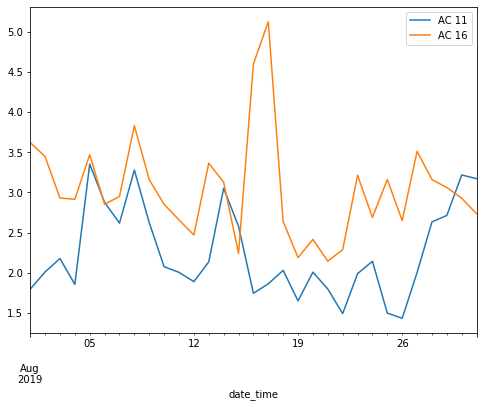

In [87]:
aug[['AC 11','AC 16']].plot()

<AxesSubplot:xlabel='date_time'>

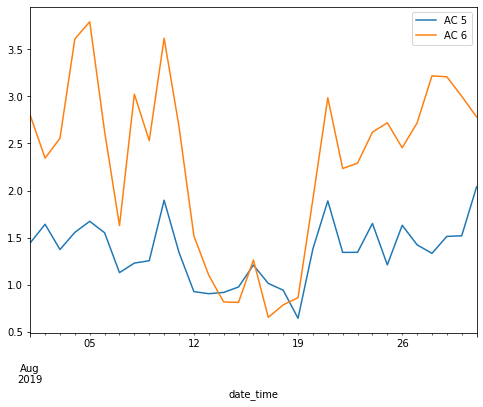

In [88]:
aug[['AC 5','AC 6']].plot()

In [89]:
## check for the same in the month of September as well

In [90]:
sep=data.loc['2019-09-01':'2019-09-30']['AC 1'].dropna().resample("D").mean()

In [91]:
sep= pd.DataFrame(sep)

In [92]:
sep.drop(['AC 1'],axis=1,inplace=True)

In [93]:
for value in column_name:
    sept=data.loc['2019-09-01':'2019-09-30'][value].dropna().resample("D").mean()
    sept= pd.DataFrame(sept)
    sep[value]=sept[value]

    

<AxesSubplot:xlabel='date_time'>

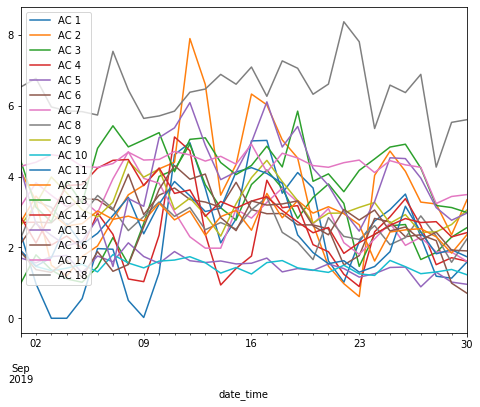

In [94]:
sep.plot()

<AxesSubplot:xlabel='date_time'>

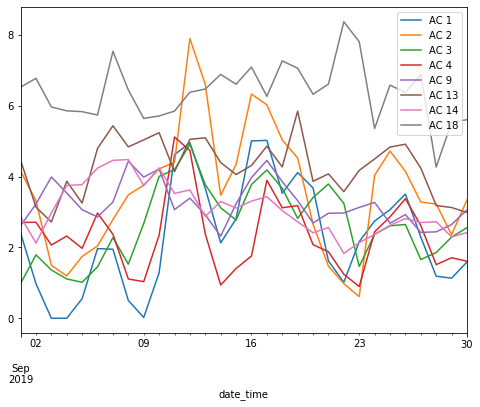

In [95]:
sep[['AC 1','AC 2','AC 3','AC 4','AC 9','AC 13','AC 14','AC 18']].plot()

<AxesSubplot:xlabel='date_time'>

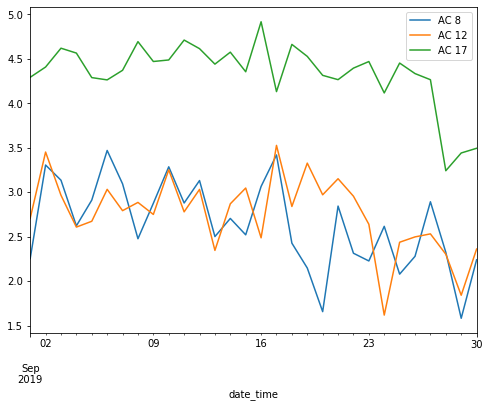

In [96]:
sep[['AC 8','AC 12','AC 17']].plot()

<AxesSubplot:xlabel='date_time'>

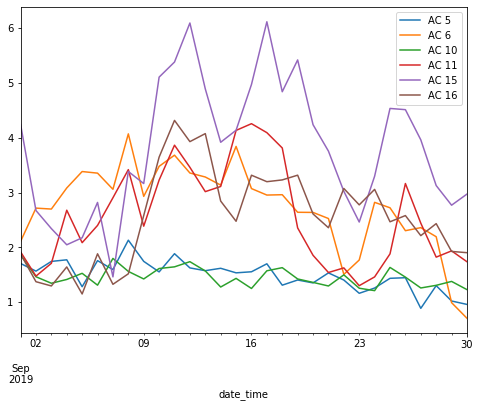

In [97]:
sep[['AC 5','AC 6','AC 10','AC 11','AC 15','AC 16']].plot()

<AxesSubplot:xlabel='date_time'>

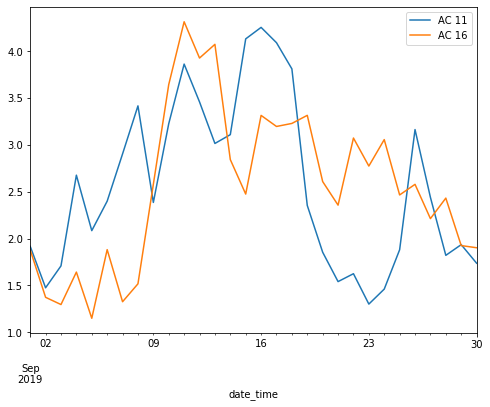

In [98]:
sep[['AC 11','AC 16']].plot()

In [99]:
## It is almost similar pattern

In [100]:
##Lets check co relation as well

In [101]:
result = pd.concat([aug,sep])

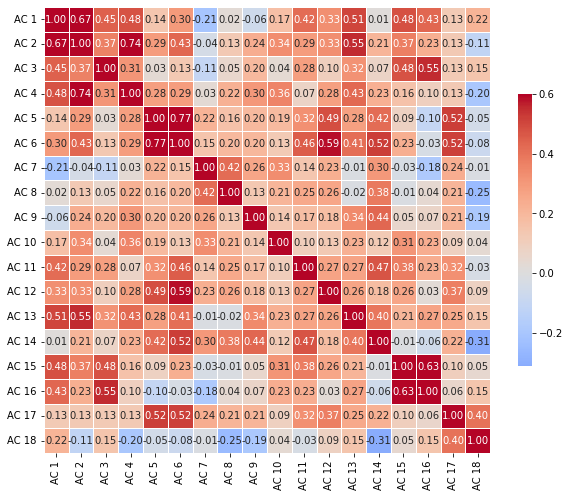

In [102]:
corr=result.corr(method='pearson')
g = sns.heatmap(corr,  vmax=.6, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt='.2f', cmap='coolwarm')
g.figure.set_size_inches(10,10)
    
plt.show()

In [103]:
corr=result[['AC 1','AC 2','AC 3','AC 4','AC 9','AC 13','AC 14','AC 18']].corr(method='pearson')
corr

,AC 1,AC 2,AC 3,AC 4,AC 9,AC 13,AC 14,AC 18
AC 1,1.000000,0.674738,0.448513,0.479091,-0.063997,0.509412,0.012637,0.215170
AC 2,0.674738,1.000000,0.367769,0.736424,0.239613,0.550632,0.205706,-0.113154
AC 3,0.448513,0.367769,1.000000,0.309510,0.197494,0.318983,0.072594,0.149029
AC 4,0.479091,0.736424,0.309510,1.000000,0.302200,0.425824,0.226432,-0.197460
AC 9,-0.063997,0.239613,0.197494,0.302200,1.000000,0.341842,0.435188,-0.192176
AC 13,0.509412,0.550632,0.318983,0.425824,0.341842,1.000000,0.396084,0.150332
AC 14,0.012637,0.205706,0.072594,0.226432,0.435188,0.396084,1.000000,-0.311491
AC 18,0.215170,-0.113154,0.149029,-0.197460,-0.192176,0.150332,-0.311491,1.000000


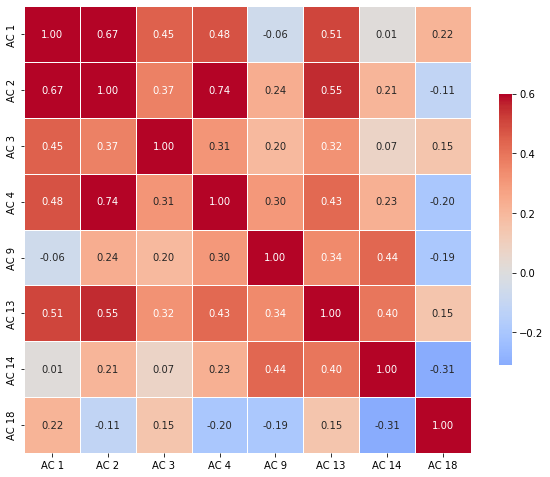

In [104]:
g = sns.heatmap(corr,  vmax=.6, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt='.2f', cmap='coolwarm')
g.figure.set_size_inches(10,10)
    
plt.show()

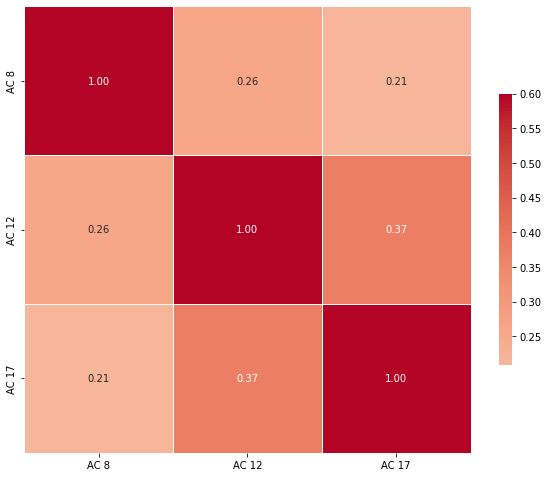

In [105]:
corr=result[['AC 8','AC 12','AC 17']].corr(method='pearson')
g = sns.heatmap(corr,  vmax=.6, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt='.2f', cmap='coolwarm')
g.figure.set_size_inches(10,10)
    
plt.show()

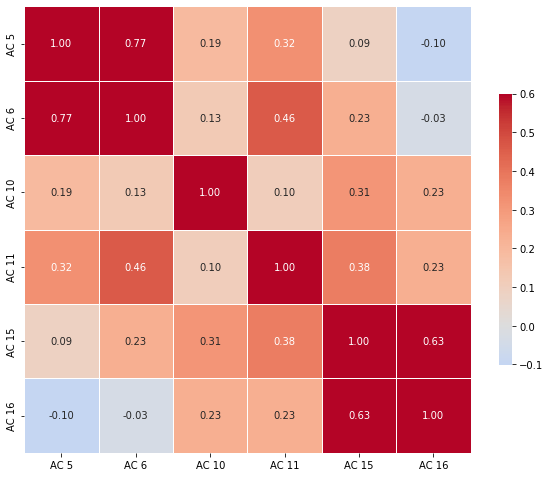

In [106]:
corr=result[['AC 5','AC 6','AC 10','AC 11','AC 15','AC 16']].corr(method='pearson')
g = sns.heatmap(corr,  vmax=.6, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt='.2f', cmap='coolwarm')
g.figure.set_size_inches(10,10)
    
plt.show()

In [107]:
final_data= data.copy()

In [108]:
for value in column_name:
    final_data[value]=data[value].fillna(method='ffill')


In [109]:
final_data.isnull().sum()

AC 1             0
AC 2             0
AC 3             0
AC 4             0
AC 5             0
AC 6             0
AC 7             0
AC 8             0
AC 9             0
AC 10            0
AC 11            0
AC 12            0
AC 13            0
AC 14            0
AC 15            0
AC 16            0
AC 17            0
AC 18            0
dates            0
time             0
day              0
weekend          0
year             0
month            0
day_of_week      0
week_in_month    0
dtype: int64

In [110]:
final_data.head()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,dates,time,day,weekend,year,month,day_of_week,week_in_month
date_time,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-08-01 00:00:00,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981,2019-08-01,00:00:00,Thursday,0,2019,8,3,1
2019-08-01 00:01:00,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981,2019-08-01,00:01:00,Thursday,0,2019,8,3,1
2019-08-01 00:02:00,7.426114,8.940615,0.0,0.0,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,2019-08-01,00:02:00,Thursday,0,2019,8,3,1
2019-08-01 00:03:00,7.426114,8.940615,0.0,0.0,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,2019-08-01,00:03:00,Thursday,0,2019,8,3,1
2019-08-01 00:04:00,7.052986,9.161103,0.0,0.0,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475,2019-08-01,00:04:00,Thursday,0,2019,8,3,1


In [111]:
grp = final_data.groupby(['day']).sum()[column_name]


In [112]:
grp

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18
day,,,,,,,,,,,,,,,,,,
Friday,36075.664748,49360.732077,36327.732371,32560.185412,18069.405611,33256.737387,35218.922493,31850.903868,36747.964254,19764.243484,30692.846501,35582.040863,56346.656016,37048.674661,52932.022191,40497.944110,54991.127003,83488.049550
Monday,22861.002116,47437.407794,30553.516390,24207.022264,17079.303391,28532.267932,38725.931869,33038.830888,41509.720180,18752.515852,28047.704592,33545.780373,48334.606818,35287.126991,48419.113775,32725.909716,53293.604153,82175.770506
Saturday,26097.039060,42124.077810,32845.671433,26800.389402,20198.717865,33329.744258,37655.854068,32141.900150,40595.952597,19772.209586,29956.737247,36048.516367,56998.169880,37960.553413,46919.046114,36446.265000,54376.895247,85677.660589
Sunday,24752.316649,44597.858607,31244.384620,23949.460329,18490.757066,32128.979402,39194.096198,28293.421141,42128.535390,19905.448714,29393.926778,34791.809304,55157.452566,36468.240934,52692.702003,32038.086653,52789.274134,87434.629359
Thursday,42331.107203,65661.362481,36578.431253,38772.023761,17749.915193,34270.454391,38850.421843,36298.365730,41738.713061,20662.641022,32952.393254,35698.970464,62501.022250,39011.385152,55335.503516,37422.512844,57018.340119,85199.744248
Tuesday,23800.544662,45874.817918,30087.730658,29937.131508,16580.266028,29247.377959,35889.407791,32808.057297,40446.921791,17621.330878,28084.382602,31329.208935,44470.107208,34655.180483,49104.520770,33603.961445,48357.379573,71319.063685
Wednesday,32768.956879,44487.528258,27937.851972,33972.225280,16707.327963,30250.648217,36118.073974,29404.004815,36146.048981,18544.161806,32305.930755,30134.594550,51806.830676,35805.642668,49603.253120,33077.759661,49725.016932,72444.838871


array([<AxesSubplot:xlabel='day'>, <AxesSubplot:xlabel='day'>,
       <AxesSubplot:xlabel='day'>, <AxesSubplot:xlabel='day'>,
       <AxesSubplot:xlabel='day'>, <AxesSubplot:xlabel='day'>,
       <AxesSubplot:xlabel='day'>, <AxesSubplot:xlabel='day'>,
       <AxesSubplot:xlabel='day'>, <AxesSubplot:xlabel='day'>,
       <AxesSubplot:xlabel='day'>, <AxesSubplot:xlabel='day'>,
       <AxesSubplot:xlabel='day'>, <AxesSubplot:xlabel='day'>,
       <AxesSubplot:xlabel='day'>, <AxesSubplot:xlabel='day'>,
       <AxesSubplot:xlabel='day'>, <AxesSubplot:xlabel='day'>],
      dtype=object)

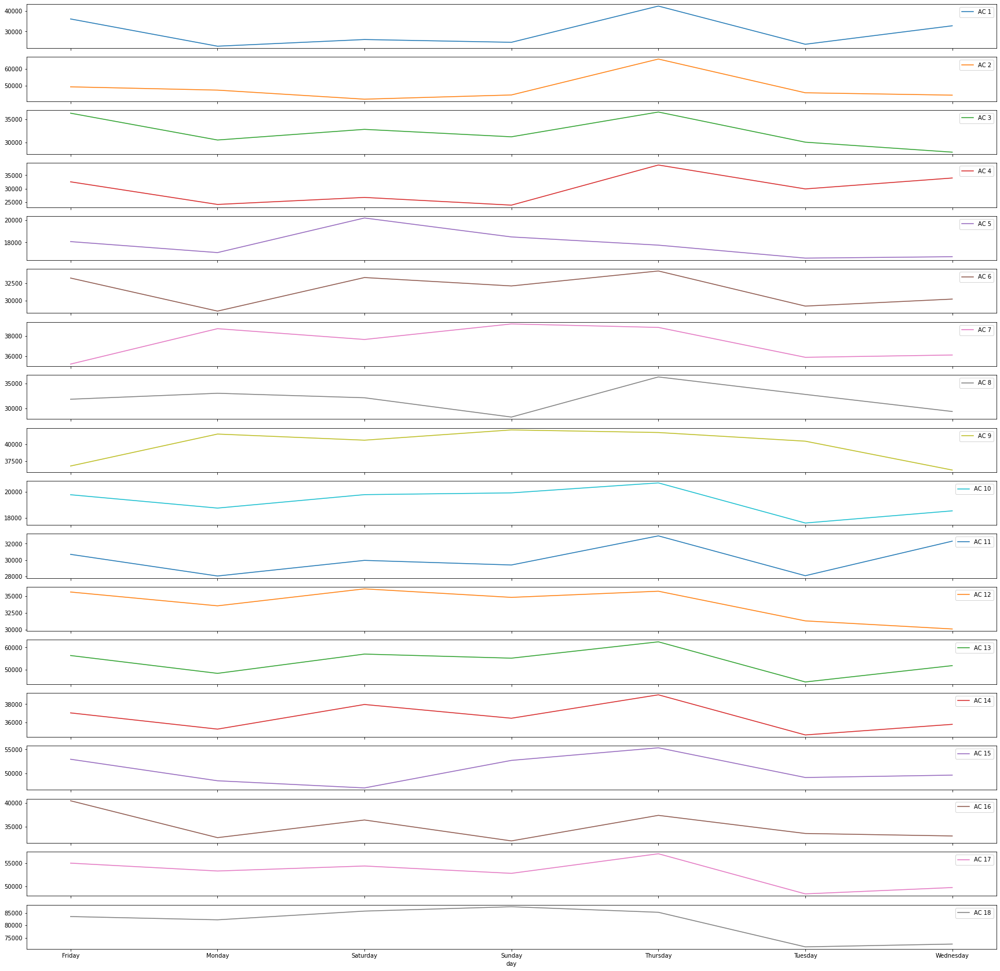

In [113]:
grp.plot(subplots=True,figsize=(30, 30))

In [114]:
## Every  Ac's has some usage pattern within the weeks

## On Thursday Every Ac has high usage  except AC 5 and somewhat AC  15 falling

In [115]:
#Monday:- AC 2 , AC 13 AC 15, AC 17 AC 18
#Tuesdy:- AC 2 , AC 9 , AC 13, AC 15, AC 17, AC 18
#Wednesday:- AC 2 , AC 13, AC 15, AC 17, AC 18
#Thursday:- AC 1 , AC 2 , AC 9 , Ac 13 , AC 15 ,AC 17, Ac 18
#Friday:-  AC 2 , AC 13 ,AC 15 , AC 16, AC 17, Ac 18
#Saturday:- AC 2 , AC 9 ,Ac 13, Ac 15 , Ac 17 , AC 18
#Sunday:- Ac 2 ,  AC ,9, AC 13 , AC 15 , AC 17, AC 18

## Above are the high usage AC based on days
## Ac 18 is always on high usage so the AC might be soemthing that is in the main hall or something like that location 
## which constanlty works maybe in reception area 

###  AC2 ,AC 13, AC 15 , Ac 17, AC 18 are  high usage AC 

In [116]:
# Almost all AC have high usage on Thursaday

In [117]:
grp = final_data.groupby('week_in_month').sum()[column_name]


array([<AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>], dtype=object)

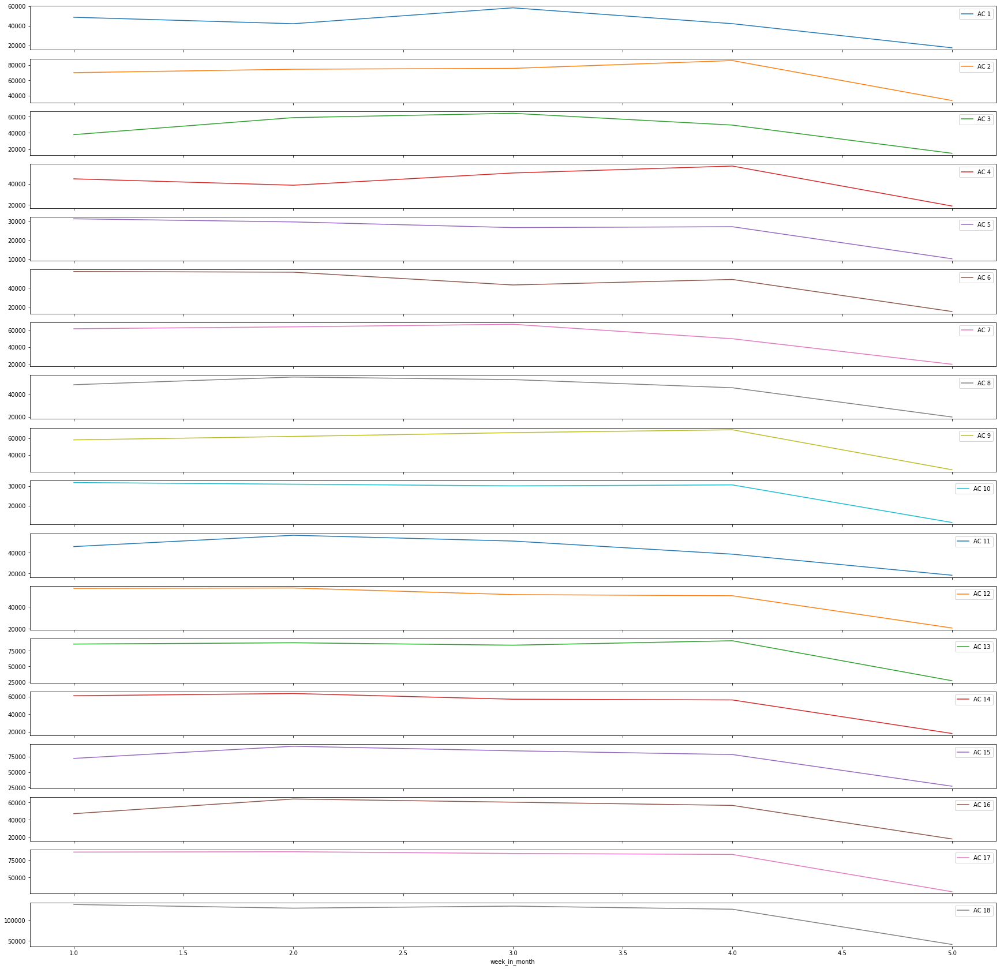

In [118]:
grp.plot(subplots=True,figsize=(30, 30))

<AxesSubplot:xlabel='week_in_month'>

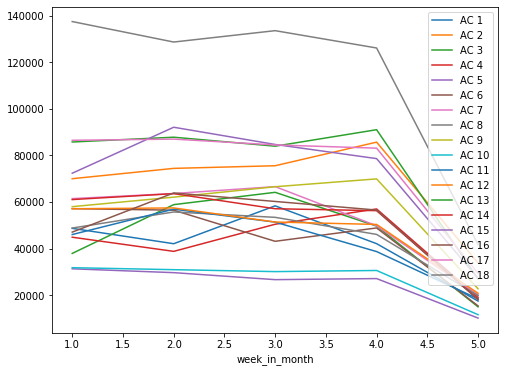

In [119]:
grp.plot()

In [120]:
grp

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18
week_in_month,,,,,,,,,,,,,,,,,,
1,48686.370612,70016.784277,37923.115894,44882.359559,31307.447670,57153.087391,61467.566606,48814.959432,58004.856337,31789.286809,46030.246561,57106.596448,85779.610977,61048.326443,72370.442267,47066.234773,86516.668391,137516.161559
2,42088.496490,74449.040083,58869.031417,38803.627613,29658.643274,56495.249770,63643.313538,55722.628930,62091.807577,30938.641833,56931.640973,57453.148584,87837.582729,63598.918021,92118.151692,63887.583293,87017.938585,128720.023538
3,58352.395527,75583.043458,64162.481169,50451.135261,26651.454019,43125.818332,66618.182393,53419.611262,66564.888345,30105.137942,51363.049506,51404.642639,83982.666624,57111.322109,84721.432261,60239.001130,84521.046984,133605.524160
4,42109.222093,85717.069789,49658.422905,57023.489759,27109.244720,48862.655098,49801.638107,46086.724710,69935.446038,30591.342810,38712.177918,50367.665000,91062.364756,56283.296495,78644.870805,56543.535672,83134.804595,126165.391999
5,17450.146596,33777.847339,14962.267311,19037.825763,10148.903435,15379.398954,20122.007591,19791.559556,22716.857956,11598.141947,18396.806771,20798.868185,26952.620328,18194.941233,27151.264465,18076.084560,29361.178606,41732.655551


In [121]:
### not sure about the pattern when group by n weeks data is not adequate to determine 

In [122]:
final_data.head()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,dates,time,day,weekend,year,month,day_of_week,week_in_month
date_time,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-08-01 00:00:00,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981,2019-08-01,00:00:00,Thursday,0,2019,8,3,1
2019-08-01 00:01:00,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981,2019-08-01,00:01:00,Thursday,0,2019,8,3,1
2019-08-01 00:02:00,7.426114,8.940615,0.0,0.0,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,2019-08-01,00:02:00,Thursday,0,2019,8,3,1
2019-08-01 00:03:00,7.426114,8.940615,0.0,0.0,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,2019-08-01,00:03:00,Thursday,0,2019,8,3,1
2019-08-01 00:04:00,7.052986,9.161103,0.0,0.0,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475,2019-08-01,00:04:00,Thursday,0,2019,8,3,1


In [123]:
## lets find out if there is any specific time where AC is high Let us first sample our data to hourly basis as it will be easy to see pattern

In [124]:
sampled_data= final_data.resample("H").mean()

In [125]:
sampled_data['time']= sampled_data.index.time

In [126]:
sampled_data.head()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,weekend,year,month,day_of_week,week_in_month,time
date_time,,,,,,,,,,,,,,,,,,,,,,,,
2019-08-01 00:00:00,6.841507,8.501703,1.801855,0.975186,2.232007,4.302977,2.677340,4.825840,3.652807,2.555998,1.652069,2.015612,4.692234,5.199325,5.651866,4.244085,2.632695,5.172505,0.0,2019.0,8.0,3.0,1.0,00:00:00
2019-08-01 01:00:00,7.407684,8.459075,1.490131,1.842207,2.236677,4.314749,2.610280,4.463227,3.053721,2.658946,1.366532,1.887252,5.108711,5.699031,5.942294,4.612226,2.580214,3.970979,0.0,2019.0,8.0,3.0,1.0,01:00:00
2019-08-01 02:00:00,7.350885,8.113246,1.482323,1.465390,1.991346,4.216204,2.753061,3.801375,3.115622,2.803299,1.528281,1.919976,4.034610,5.022749,6.213989,5.267167,2.734928,3.949934,0.0,2019.0,8.0,3.0,1.0,02:00:00
2019-08-01 03:00:00,6.639281,7.923313,2.238207,1.440677,2.091048,4.734834,3.044784,3.895697,2.844864,2.731836,1.121758,1.670987,4.400518,5.034446,4.935977,5.001503,4.238698,3.898287,0.0,2019.0,8.0,3.0,1.0,03:00:00
2019-08-01 04:00:00,6.597653,7.300900,1.744991,2.547984,1.872143,3.600600,2.918532,3.768754,3.383187,2.597658,1.206639,1.836803,3.972867,4.283286,5.323463,4.811916,4.192009,3.937752,0.0,2019.0,8.0,3.0,1.0,04:00:00


In [127]:
grp = sampled_data.groupby('time').sum()[column_name]


In [128]:
grp

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18
time,,,,,,,,,,,,,,,,,,
00:00:00,192.191730,261.771122,174.401714,167.037858,97.331357,191.027393,217.320318,207.161785,228.526864,117.968593,193.310190,210.530640,307.381958,247.144357,303.368114,220.365758,209.886703,345.113032
01:00:00,195.926208,262.040056,180.691331,171.127191,95.655506,196.343450,217.401049,206.133505,231.366582,116.942432,195.590947,211.147502,297.447903,246.430971,300.159053,221.865829,191.209443,287.744197
02:00:00,194.793041,260.173078,174.937721,171.061728,96.987705,200.247843,210.018539,205.950655,226.867423,118.186110,192.498405,213.318132,283.604973,238.562335,309.055122,215.023016,195.391803,252.680273
03:00:00,193.816414,257.160003,170.648666,167.228323,96.095711,195.227262,205.785164,201.193558,223.443241,118.597445,197.493983,211.225397,275.227459,237.811711,304.318187,207.127701,196.383552,251.555350
04:00:00,186.918517,254.286048,169.332012,162.483939,94.478671,190.252446,204.391819,194.231875,220.440120,115.132438,187.573938,204.235810,271.210389,228.285636,298.811870,203.038348,209.402463,268.719957
05:00:00,185.095888,247.405465,164.649454,156.249369,91.883409,179.215941,199.316671,185.097154,215.478360,111.908635,182.123860,196.306377,262.171981,224.704858,294.375782,195.653832,216.789506,278.848222
06:00:00,170.143172,236.747301,160.371485,150.644188,87.097916,171.319150,198.722351,178.383077,214.864438,106.608090,171.131067,186.665351,258.219638,207.842840,280.859542,185.584822,229.082567,339.189738
07:00:00,149.649089,235.205094,159.310554,141.070278,85.645538,159.063271,187.512053,163.082764,206.942657,102.163268,156.054530,179.650811,252.827946,193.427755,262.148868,179.540119,248.162841,409.598595
08:00:00,127.102324,225.367539,150.156348,134.903291,83.675107,148.304583,194.237936,155.204100,186.241535,92.281150,153.605693,158.707481,247.476474,169.253584,254.366720,166.948010,271.899796,466.989260


<AxesSubplot:xlabel='time'>

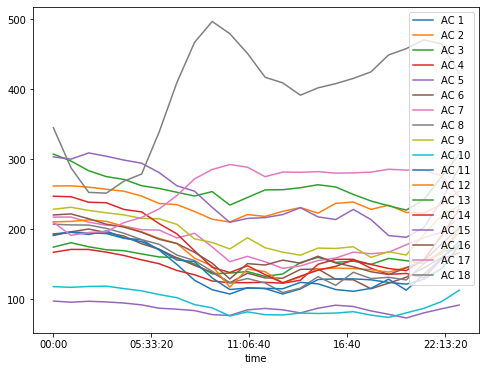

In [129]:
grp.plot()

array([<AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>,
       <AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>,
       <AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>,
       <AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>,
       <AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>,
       <AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>,
       <AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>,
       <AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>,
       <AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>],
      dtype=object)

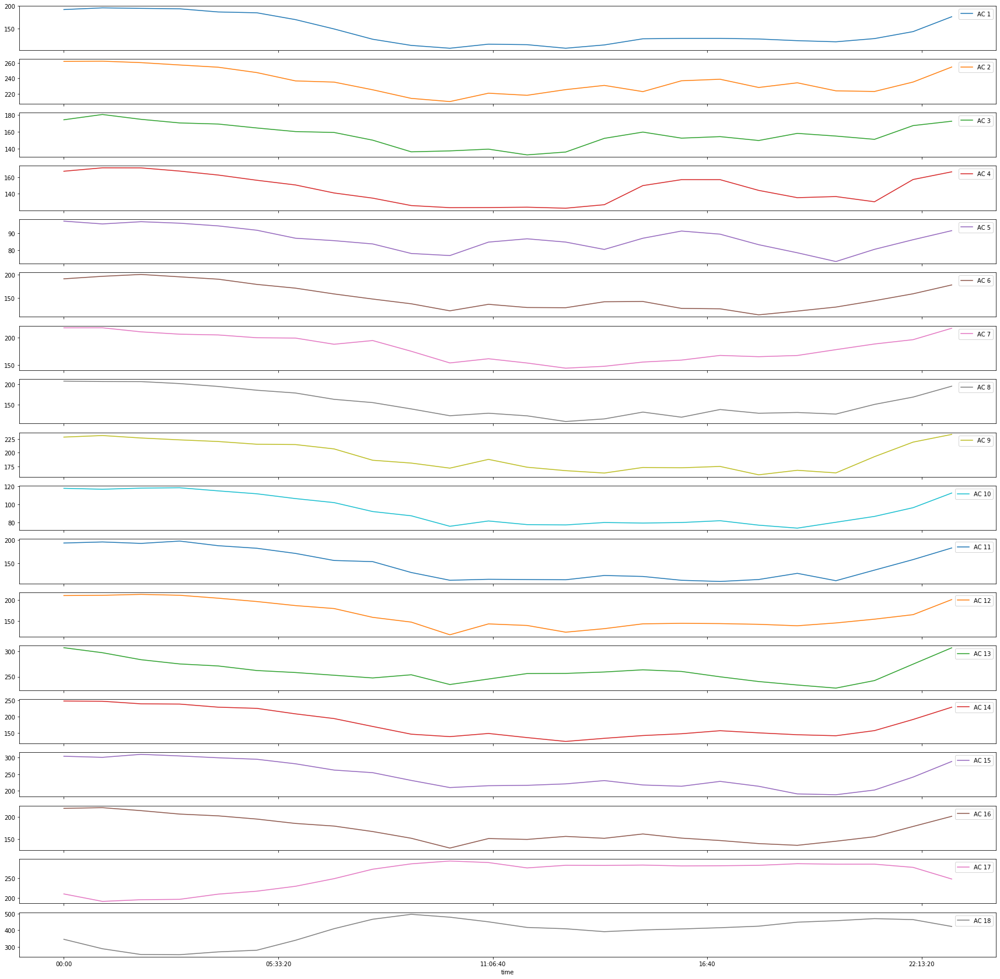

In [130]:
grp.plot(subplots=True,figsize=(30, 30))

In [131]:
# According to the past weather data during the year 2019 from august till spetember weather was cloudy and as well as rainy in august

In [132]:
# Most of the time there are temperature fluctuations from 9Am to 2 Pm during this month of the period
# This might also be affecting the data

In [133]:
# Between 10:AM to 12 PM there is sudden peak in most of the AC

In [134]:
## Now if see our power usage of AC in the hours we can note that
## Almost all AC have increase usage from 10pm  till 9: AM
##  Exception of above observation is  AC 17 and AC 18
## We also know that this AC are High usage AC especially AC 18
## All other AC might be AC which are present in the hotel room

## AC 17 , AC 18 might be the AC which might be present in the reception area or some common area


In [135]:
## Based On Hourly usage lets group AC No's Together
## AC 2 , AC 3 , AC 4
## AC 5 , AC 6 
## AC 7 , AC 8, AC 9
## AC 10, AC 11, AC 12 , Ac 13
## AC 14, AC 15, AC 16,
## AC 17, AC 18

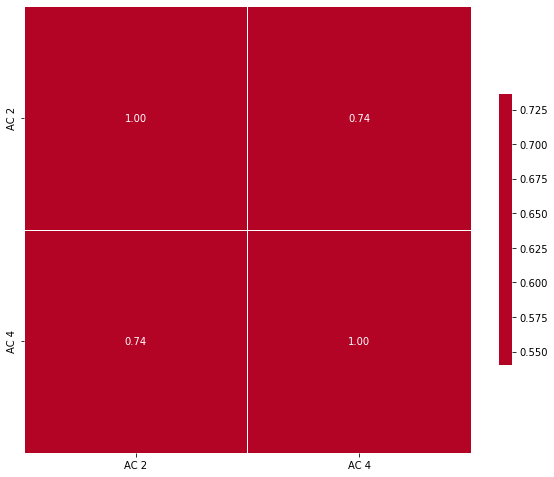

In [136]:
corr=result[['AC 2','AC 4']].corr(method='pearson')
g = sns.heatmap(corr,  vmax=.6, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt='.2f', cmap='coolwarm')
g.figure.set_size_inches(10,10)
    
plt.show()

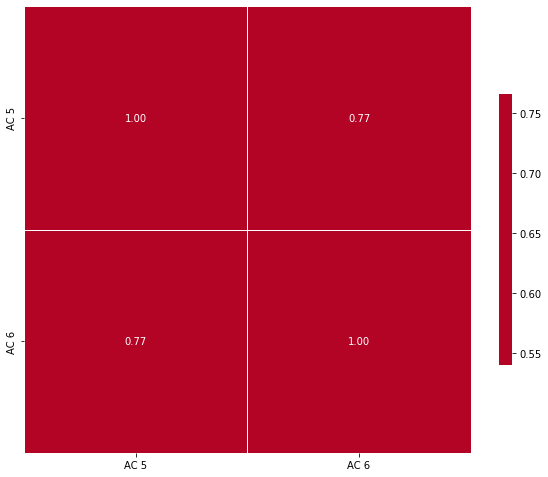

In [137]:
corr=result[['AC 5','AC 6']].corr(method='pearson')
g = sns.heatmap(corr,  vmax=.6, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt='.2f', cmap='coolwarm')
g.figure.set_size_inches(10,10)
    
plt.show()

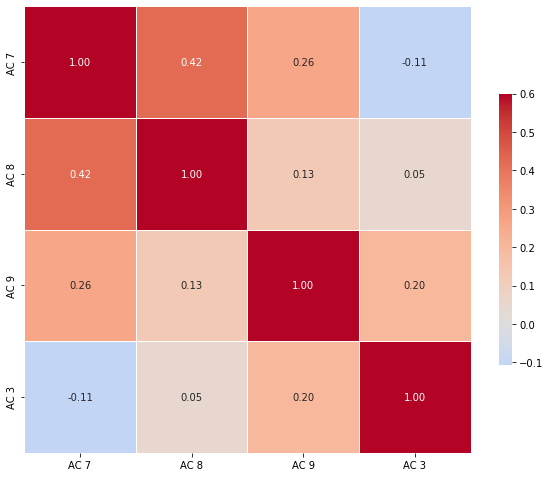

In [138]:
corr=result[['AC 7','AC 8','AC 9','AC 3']].corr(method='pearson')
g = sns.heatmap(corr,  vmax=.6, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt='.2f', cmap='coolwarm')
g.figure.set_size_inches(10,10)
    
plt.show()



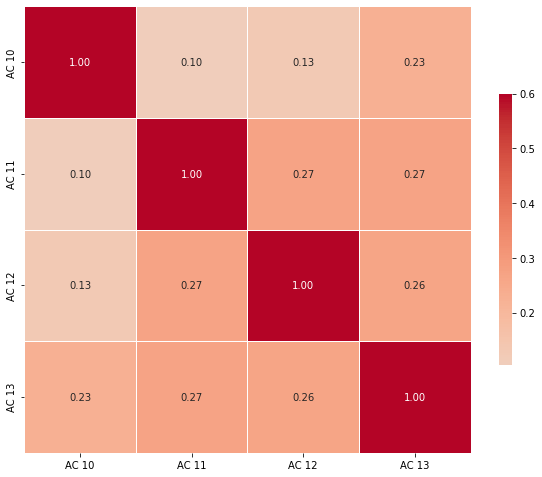

In [139]:

corr=result[['AC 10','AC 11','AC 12','AC 13']].corr(method='pearson')
g = sns.heatmap(corr,  vmax=.6, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt='.2f', cmap='coolwarm')
g.figure.set_size_inches(10,10)
    
plt.show()



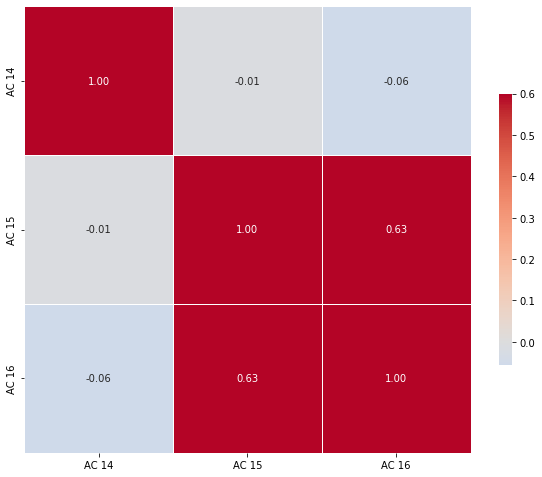

In [140]:
# AC 14, AC 15, AC 16,

corr=result[['AC 14','AC 15','AC 16']].corr(method='pearson')
g = sns.heatmap(corr,  vmax=.6, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt='.2f', cmap='coolwarm')
g.figure.set_size_inches(10,10)
    
plt.show()



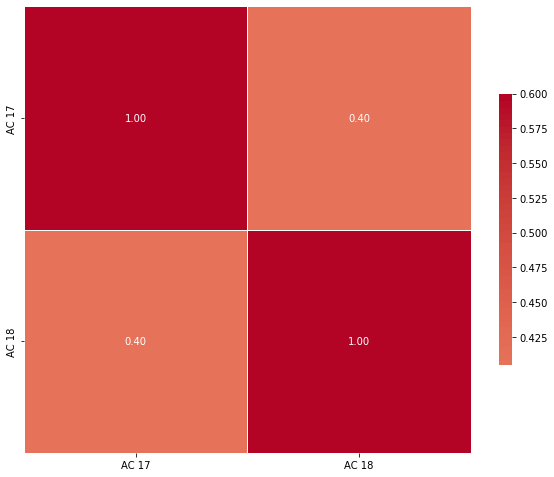

In [141]:
# AC 17, AC 18
# AC 14, AC 15, AC 16,

corr=result[['AC 17','AC 18']].corr(method='pearson')
g = sns.heatmap(corr,  vmax=.6, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt='.2f', cmap='coolwarm')
g.figure.set_size_inches(10,10)
    
plt.show()



In [142]:
### Lets find Seasonality or pattern in the data


In [143]:
final_data.head()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,dates,time,day,weekend,year,month,day_of_week,week_in_month
date_time,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-08-01 00:00:00,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981,2019-08-01,00:00:00,Thursday,0,2019,8,3,1
2019-08-01 00:01:00,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981,2019-08-01,00:01:00,Thursday,0,2019,8,3,1
2019-08-01 00:02:00,7.426114,8.940615,0.0,0.0,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,2019-08-01,00:02:00,Thursday,0,2019,8,3,1
2019-08-01 00:03:00,7.426114,8.940615,0.0,0.0,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,2019-08-01,00:03:00,Thursday,0,2019,8,3,1
2019-08-01 00:04:00,7.052986,9.161103,0.0,0.0,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475,2019-08-01,00:04:00,Thursday,0,2019,8,3,1


<AxesSubplot:xlabel='date_time'>

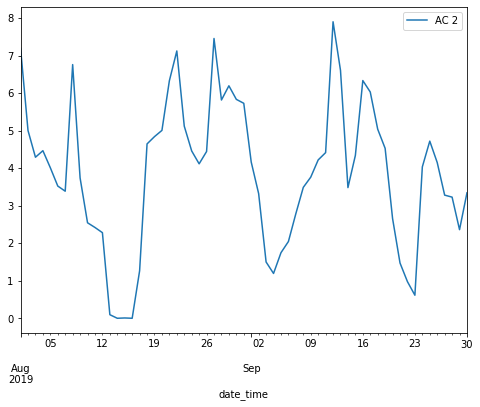

In [144]:
august_data= final_data[['AC 2']].resample('D').mean()
august_data.plot()

In [145]:
# here usage pattern is almost similar on monthly basis since weh aave only two months data we cant say for sure

In [146]:
## Lets check the power usage at 15th august or around those days compare to regular days

In [147]:
## Here we will   take only august data and sample it on week level
august_data= final_data.loc['2019-08-01':'2019-08-31']

In [148]:
grp = august_data.groupby('week_in_month').sum()[column_name]


<AxesSubplot:xlabel='week_in_month'>

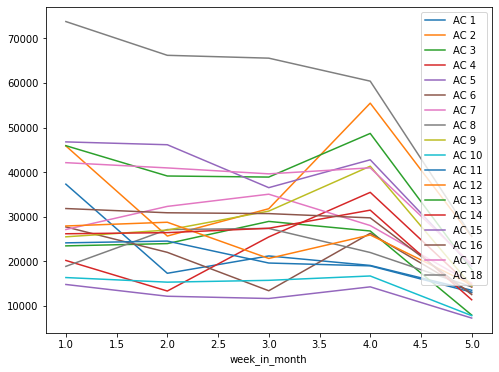

In [149]:
grp.plot()

array([<AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>], dtype=object)

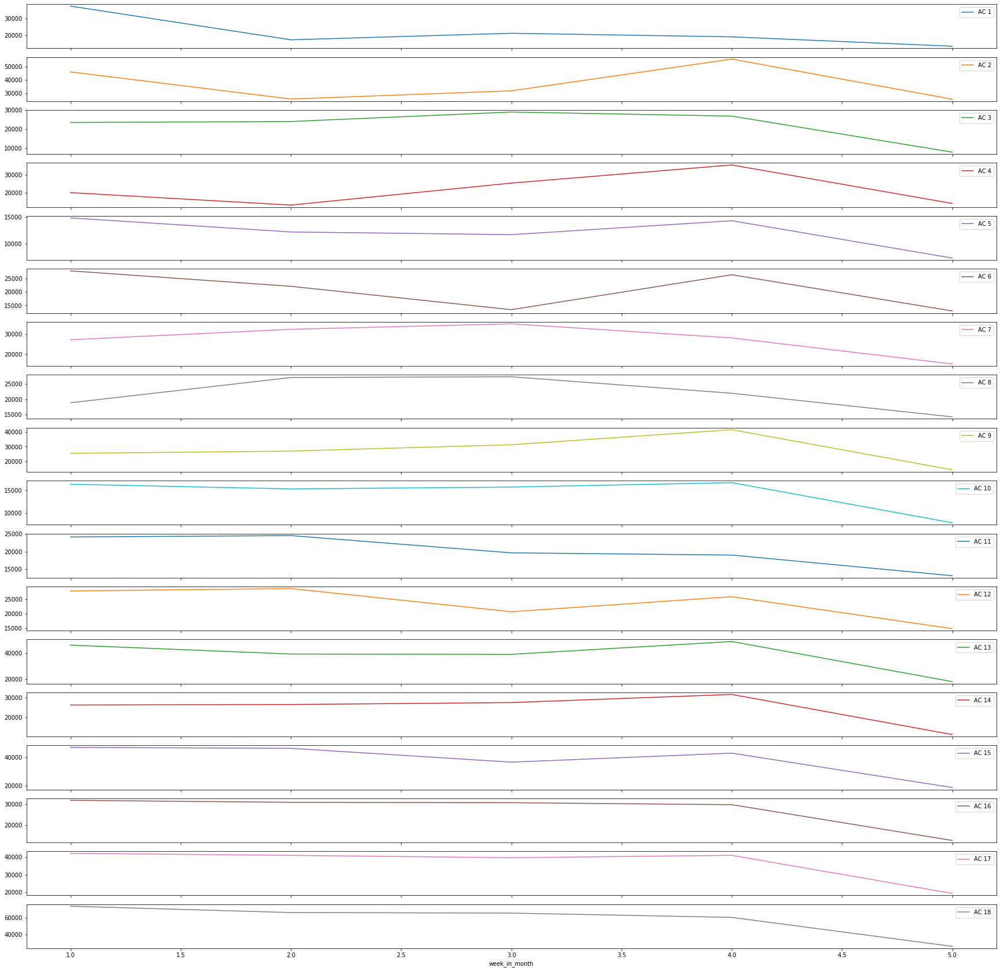

In [150]:
grp.plot(subplots=True,figsize=(30, 30))

In [151]:
## We will see tha pattern of week sampling in the month of September as well to draw somm conclusion

In [152]:
sep_data= final_data.loc['2019-09-01':'2019-09-30']

In [153]:
grp = sep_data.groupby('week_in_month').sum()[column_name]


<AxesSubplot:xlabel='week_in_month'>

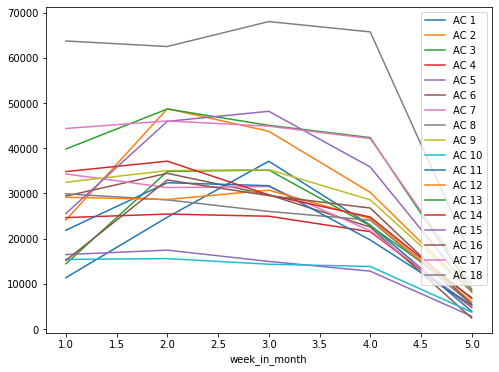

In [154]:
grp.plot()

array([<AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>,
       <AxesSubplot:xlabel='week_in_month'>], dtype=object)

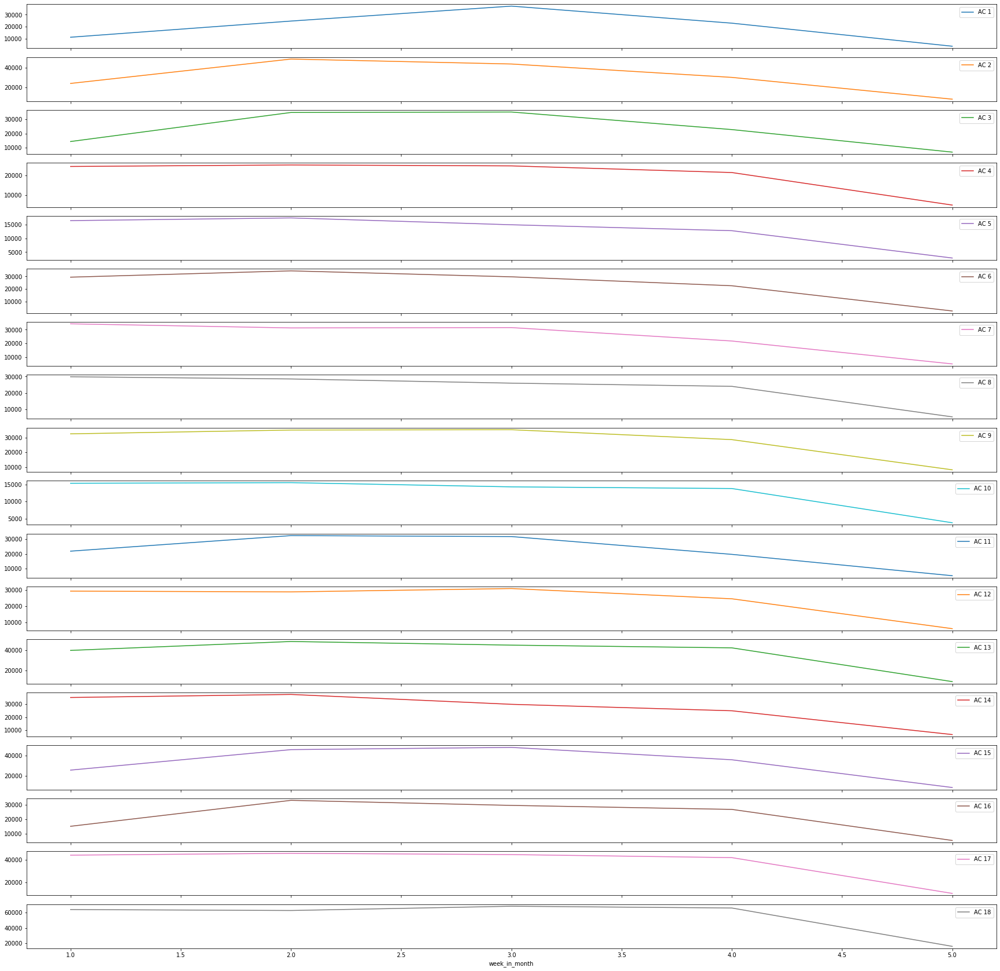

In [155]:
grp.plot(subplots=True,figsize=(30, 30))

In [156]:
## Here in the month of September our power usage his started increasing from the first week itself
## One thing is common that power usage falls at the end of the month
## since we have only two month of data nothing can be said to be concrete
## But there is drastic fall in the both month ends 
## Temperature can also be factor which still we have not considered yet
## Temperature might have decreased towards the month end in both the months thats why there is drastic fall at the end

In [157]:
### Let us find out the Highest usage of AC 

In [158]:
final_data.describe()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,weekend,year,month,day_of_week,week_in_month
count,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.0,87840.000000,87840.000000,87840.000000
mean,2.375759,3.865480,2.568025,2.392969,1.421627,2.516123,2.978742,2.548218,3.179803,1.537142,2.407035,2.699578,4.276125,2.917086,4.041509,2.798411,4.218484,6.463340,0.295082,2019.0,8.491803,3.049180,2.704918
std,2.276966,2.544012,1.490573,1.796812,0.770244,1.656469,1.473159,1.502818,1.523585,0.687425,1.553872,1.437566,1.847434,1.456109,2.018451,1.605235,1.126705,2.320423,0.456082,0.0,0.499936,2.011668,1.271952
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2019.0,8.000000,0.000000,1.000000
25%,0.000000,2.119757,1.704856,1.256370,0.970037,1.539446,2.185964,1.768169,2.292817,1.116352,1.592256,1.946965,3.256553,1.853620,3.022290,1.876071,3.752156,4.012668,0.000000,2019.0,8.000000,1.000000,2.000000
50%,2.090838,3.790670,2.486820,2.307461,1.379510,2.663660,3.003045,2.608301,3.079047,1.502662,2.351409,2.726764,4.212937,2.785877,3.999026,2.670240,4.611717,7.132416,0.000000,2019.0,8.000000,3.000000,3.000000
75%,3.661389,5.456515,3.445363,3.473311,1.870613,3.615400,3.896072,3.492490,4.090830,1.962944,3.256025,3.568081,5.376589,3.825768,5.254144,3.691661,4.958148,8.318468,1.000000,2019.0,9.000000,5.000000,4.000000
max,11.194789,11.147141,8.430909,9.879500,5.495358,9.929291,9.356776,9.331506,10.026747,4.625030,10.363151,9.887306,9.796393,9.054969,10.349998,10.654430,5.950261,11.040031,1.000000,2019.0,9.000000,6.000000,5.000000


In [159]:
final_data.sum(axis = 0, skipna = True)


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.



AC 1                                                 208686.631318
AC 2                                                 339543.784946
AC 3                                                 225575.318697
AC 4                                                 210198.437956
AC 5                                                 124875.693117
AC 6                                                 221016.209546
AC 7                                                 261652.708235
AC 8                                                  223835.48389
AC 9                                                 279313.856254
AC 10                                                135022.551342
AC 11                                                211433.921729
AC 12                                                237130.920856
AC 13                                                375614.845414
AC 14                                                256236.804301
AC 15                                                355006.16

In [160]:
## Here we are considering usage based on power consumption of AC
### Ac 18 has the highest usage with respect to the power
### Ac 8 is the least of all

### AC 13 , Ac 15 , Ac 17 , Ac 2 have also high power consumption 

In [161]:
## The next Thing we will consider is temperature Data 
## We will try to bring temperature data and compare it with the power usage of AC's
## The more the Temperature More should be the power consumption as well 


In [162]:
### I have fetch temperature data from free api this data is in hourly format till the range we have our ac power consuption data

In [163]:
temperature= pd.read_csv('../input/temperature/Temperature.csv')

In [164]:
temperature.head()

,date_time,maxtempC,mintempC,totalSnow_cm,sunHour,uvIndex,moon_illumination,moonrise,moonset,sunrise,sunset,DewPointC,FeelsLikeC,HeatIndexC,WindChillC,WindGustKmph,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph,city
0,2019-08-01 00:00:00,36,30,0.0,13.7,9,0,05:37 AM,07:38 PM,05:44 AM,07:13 PM,21,35,35,31,13,15,56,0.0,998,31,10,86,11,Gurgaon
1,2019-08-01 01:00:00,36,30,0.0,13.7,9,0,05:37 AM,07:38 PM,05:44 AM,07:13 PM,22,34,34,31,14,19,58,0.0,998,31,10,96,11,Gurgaon
2,2019-08-01 02:00:00,36,30,0.0,13.7,9,0,05:37 AM,07:38 PM,05:44 AM,07:13 PM,22,34,34,31,14,23,60,0.0,998,31,10,107,11,Gurgaon
3,2019-08-01 03:00:00,36,30,0.0,13.7,9,0,05:37 AM,07:38 PM,05:44 AM,07:13 PM,22,34,34,30,14,28,62,0.0,998,30,10,118,11,Gurgaon
4,2019-08-01 04:00:00,36,30,0.0,13.7,9,0,05:37 AM,07:38 PM,05:44 AM,07:13 PM,23,35,35,31,14,28,61,0.0,999,31,10,121,11,Gurgaon


In [165]:
temperature.shape

(1464, 25)

In [166]:
hourly_data=final_data[column_name].resample('H').mean()


In [167]:
hourly_data.shape

(1464, 18)

In [168]:
temperature.set_index('date_time',inplace=True)
temperature.head()

,maxtempC,mintempC,totalSnow_cm,sunHour,uvIndex,moon_illumination,moonrise,moonset,sunrise,sunset,DewPointC,FeelsLikeC,HeatIndexC,WindChillC,WindGustKmph,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph,city
date_time,,,,,,,,,,,,,,,,,,,,,,,,
2019-08-01 00:00:00,36,30,0.0,13.7,9,0,05:37 AM,07:38 PM,05:44 AM,07:13 PM,21,35,35,31,13,15,56,0.0,998,31,10,86,11,Gurgaon
2019-08-01 01:00:00,36,30,0.0,13.7,9,0,05:37 AM,07:38 PM,05:44 AM,07:13 PM,22,34,34,31,14,19,58,0.0,998,31,10,96,11,Gurgaon
2019-08-01 02:00:00,36,30,0.0,13.7,9,0,05:37 AM,07:38 PM,05:44 AM,07:13 PM,22,34,34,31,14,23,60,0.0,998,31,10,107,11,Gurgaon
2019-08-01 03:00:00,36,30,0.0,13.7,9,0,05:37 AM,07:38 PM,05:44 AM,07:13 PM,22,34,34,30,14,28,62,0.0,998,30,10,118,11,Gurgaon
2019-08-01 04:00:00,36,30,0.0,13.7,9,0,05:37 AM,07:38 PM,05:44 AM,07:13 PM,23,35,35,31,14,28,61,0.0,999,31,10,121,11,Gurgaon


In [169]:
temperature.columns

Index(['maxtempC', 'mintempC', 'totalSnow_cm', 'sunHour', 'uvIndex',
       'moon_illumination', 'moonrise', 'moonset', 'sunrise', 'sunset',
       'DewPointC', 'FeelsLikeC', 'HeatIndexC', 'WindChillC', 'WindGustKmph',
       'cloudcover', 'humidity', 'precipMM', 'pressure', 'tempC', 'visibility',
       'winddirDegree', 'windspeedKmph', 'city'],
      dtype='object')

In [170]:
temp_col=['maxtempC', 'mintempC', 'totalSnow_cm', 'sunHour', 'uvIndex',
       'moon_illumination', 'moonrise', 'moonset', 'sunrise', 'sunset',
       'DewPointC', 'FeelsLikeC', 'HeatIndexC', 'WindChillC', 'WindGustKmph',
       'cloudcover', 'humidity', 'precipMM', 'pressure', 'tempC', 'visibility',
       'winddirDegree', 'windspeedKmph', 'city']

In [171]:
for value in temp_col:
    hourly_data[value]= temperature[value].to_list()

In [172]:
hourly_data.head()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,maxtempC,mintempC,totalSnow_cm,sunHour,uvIndex,moon_illumination,moonrise,moonset,sunrise,sunset,DewPointC,FeelsLikeC,HeatIndexC,WindChillC,WindGustKmph,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph,city
date_time,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-08-01 00:00:00,6.841507,8.501703,1.801855,0.975186,2.232007,4.302977,2.677340,4.825840,3.652807,2.555998,1.652069,2.015612,4.692234,5.199325,5.651866,4.244085,2.632695,5.172505,36,30,0.0,13.7,9,0,05:37 AM,07:38 PM,05:44 AM,07:13 PM,21,35,35,31,13,15,56,0.0,998,31,10,86,11,Gurgaon
2019-08-01 01:00:00,7.407684,8.459075,1.490131,1.842207,2.236677,4.314749,2.610280,4.463227,3.053721,2.658946,1.366532,1.887252,5.108711,5.699031,5.942294,4.612226,2.580214,3.970979,36,30,0.0,13.7,9,0,05:37 AM,07:38 PM,05:44 AM,07:13 PM,22,34,34,31,14,19,58,0.0,998,31,10,96,11,Gurgaon
2019-08-01 02:00:00,7.350885,8.113246,1.482323,1.465390,1.991346,4.216204,2.753061,3.801375,3.115622,2.803299,1.528281,1.919976,4.034610,5.022749,6.213989,5.267167,2.734928,3.949934,36,30,0.0,13.7,9,0,05:37 AM,07:38 PM,05:44 AM,07:13 PM,22,34,34,31,14,23,60,0.0,998,31,10,107,11,Gurgaon
2019-08-01 03:00:00,6.639281,7.923313,2.238207,1.440677,2.091048,4.734834,3.044784,3.895697,2.844864,2.731836,1.121758,1.670987,4.400518,5.034446,4.935977,5.001503,4.238698,3.898287,36,30,0.0,13.7,9,0,05:37 AM,07:38 PM,05:44 AM,07:13 PM,22,34,34,30,14,28,62,0.0,998,30,10,118,11,Gurgaon
2019-08-01 04:00:00,6.597653,7.300900,1.744991,2.547984,1.872143,3.600600,2.918532,3.768754,3.383187,2.597658,1.206639,1.836803,3.972867,4.283286,5.323463,4.811916,4.192009,3.937752,36,30,0.0,13.7,9,0,05:37 AM,07:38 PM,05:44 AM,07:13 PM,23,35,35,31,14,28,61,0.0,999,31,10,121,11,Gurgaon


array([<AxesSubplot:xlabel='date_time'>, <AxesSubplot:xlabel='date_time'>],
      dtype=object)

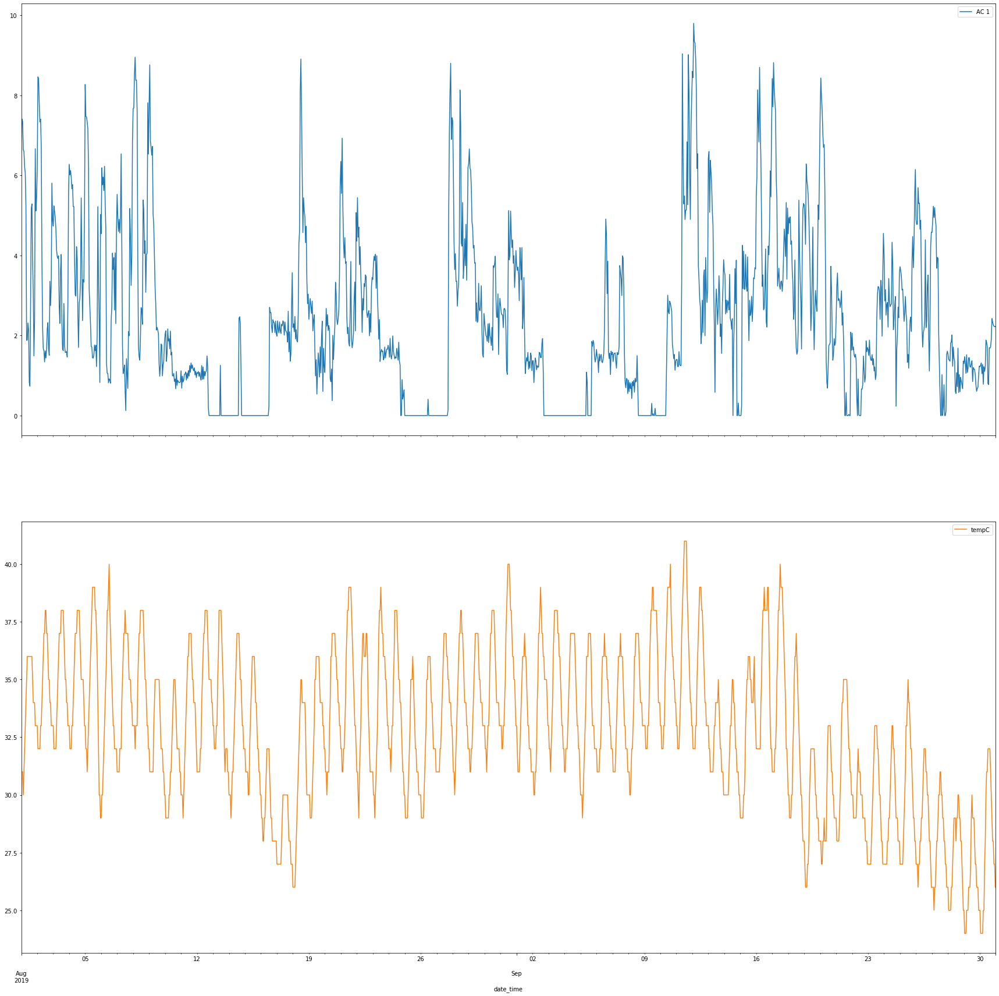

In [173]:
hourly_data[['AC 1','tempC']].plot(subplots=True,figsize=(30, 30))

array([<AxesSubplot:xlabel='date_time'>, <AxesSubplot:xlabel='date_time'>],
      dtype=object)

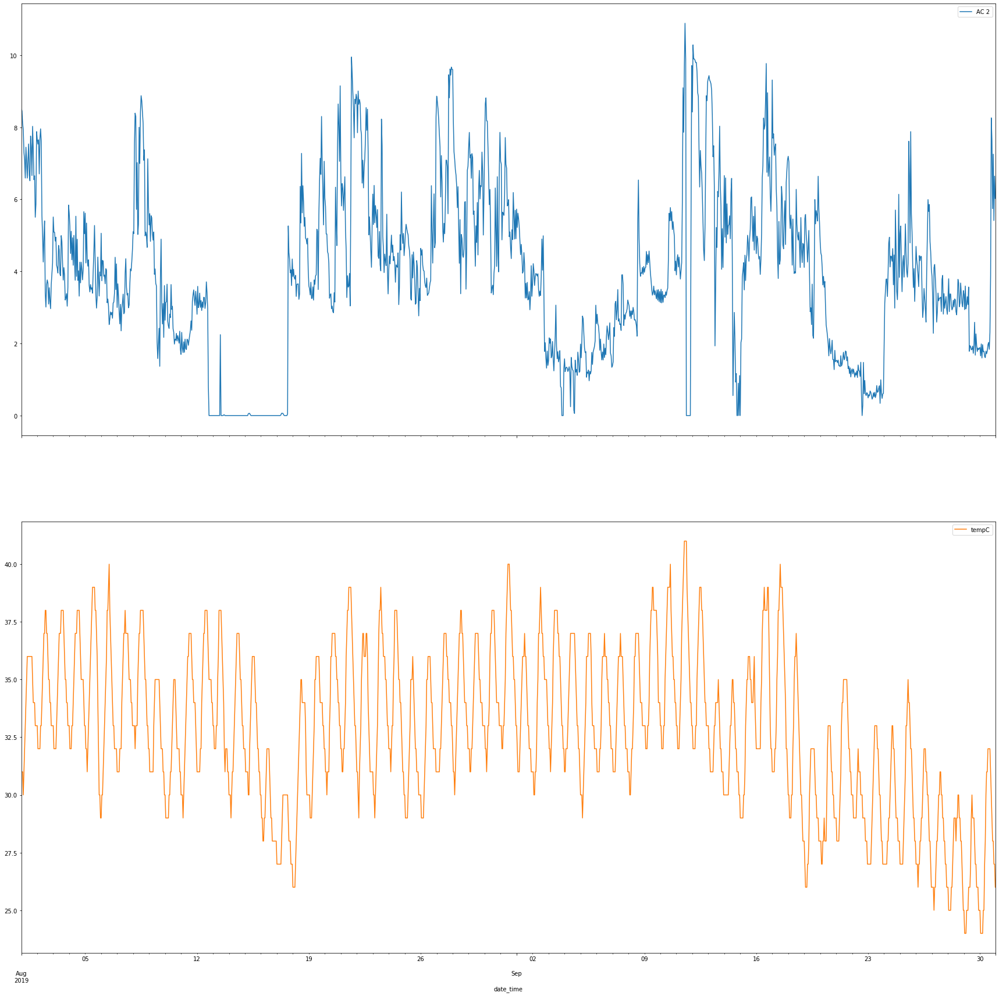

In [174]:
hourly_data[['AC 2','tempC']].plot(subplots=True,figsize=(30, 30))

array([<AxesSubplot:xlabel='date_time'>, <AxesSubplot:xlabel='date_time'>],
      dtype=object)

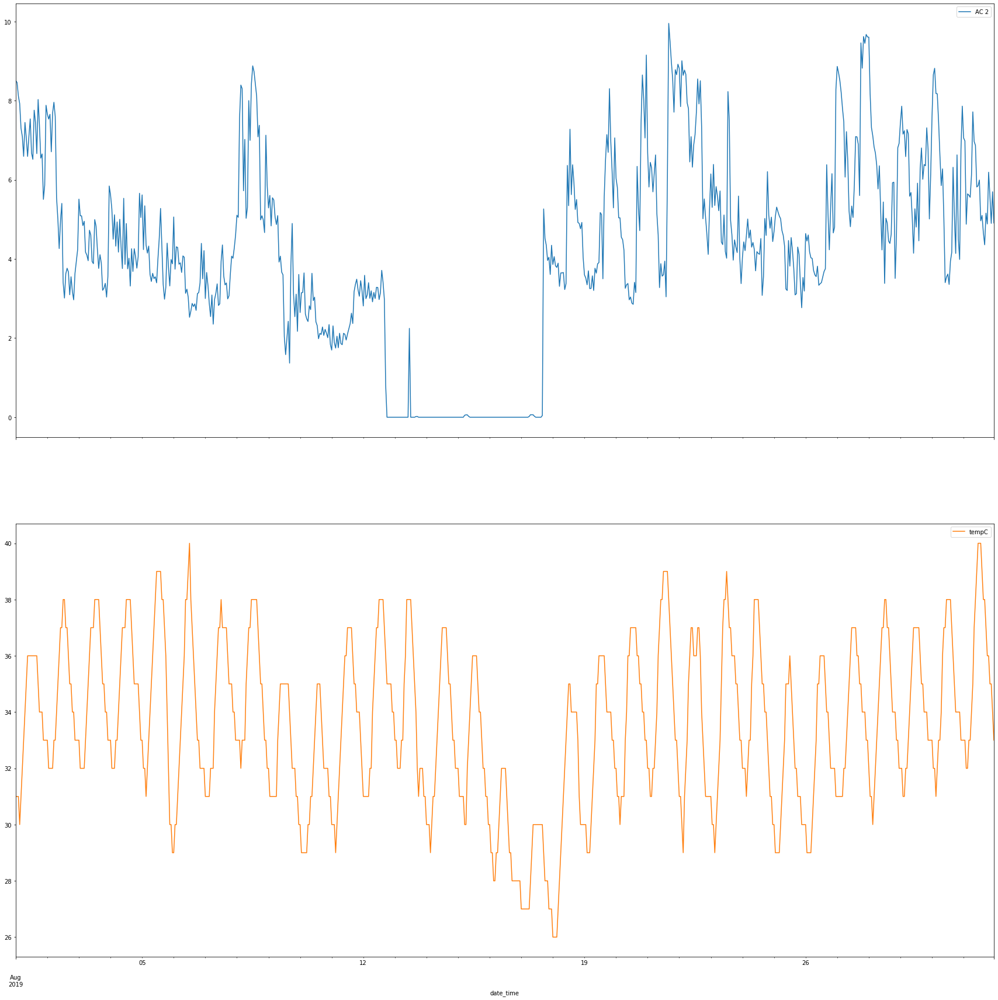

In [175]:
hourly_data.loc['2019-08-01':'2019-08-31'][['AC 2','tempC']].plot(subplots=True,figsize=(30, 30))

array([<AxesSubplot:xlabel='date_time'>, <AxesSubplot:xlabel='date_time'>],
      dtype=object)

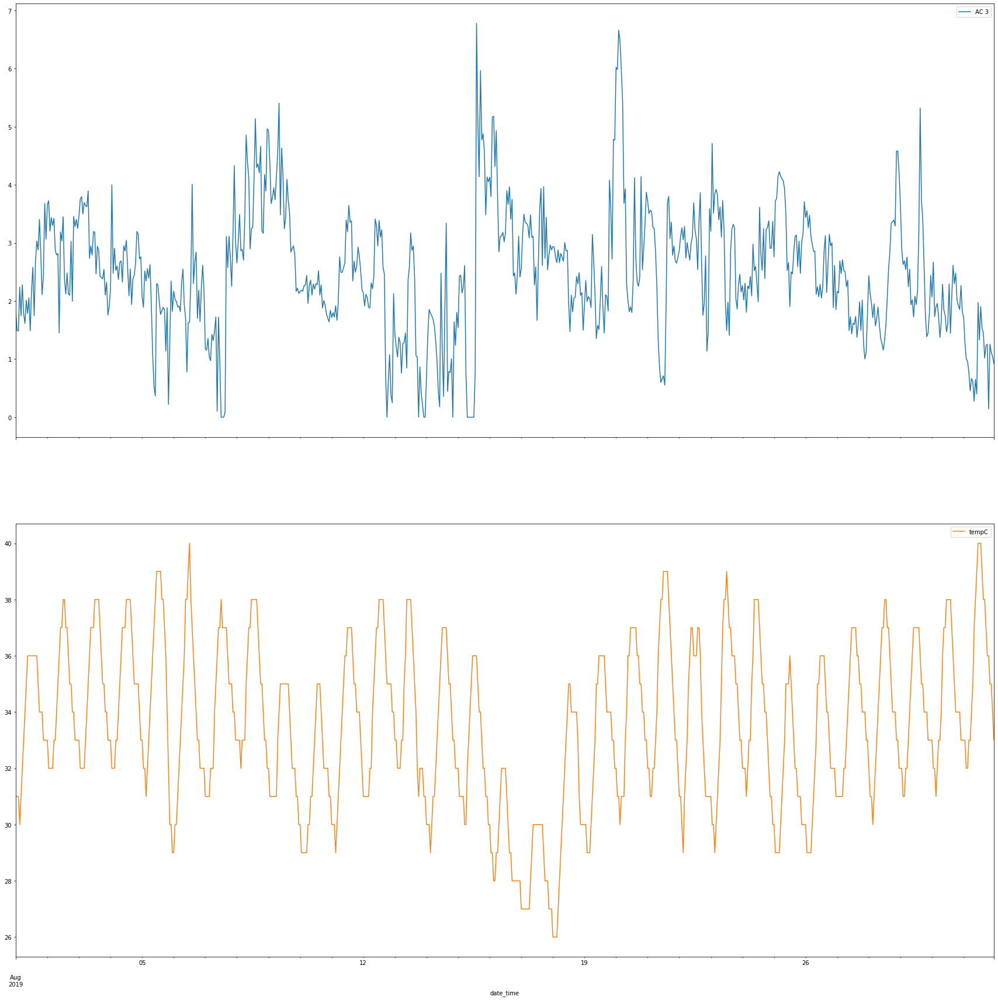

In [176]:
hourly_data.loc['2019-08-01':'2019-08-31'][['AC 3','tempC']].plot(subplots=True,figsize=(30, 30))

array([<AxesSubplot:xlabel='date_time'>, <AxesSubplot:xlabel='date_time'>],
      dtype=object)

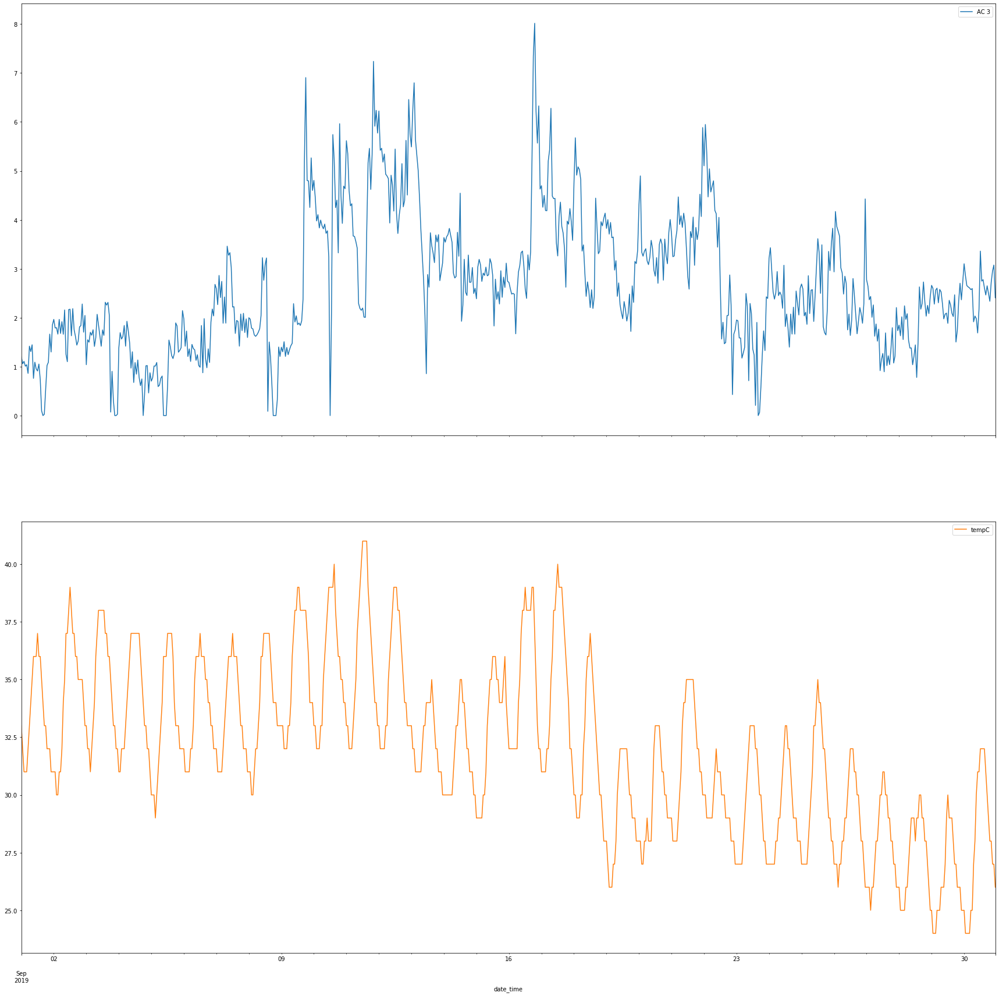

In [177]:
hourly_data.loc['2019-09-01':'2019-09-30'][['AC 3','tempC']].plot(subplots=True,figsize=(30, 30))

In [178]:
## we can see temperature fall in the month of september end which might be explaining the reason for the month end low usage 
## We cant say same for the month of august 

In [179]:
## let see for other feature as well  since we have more than temperature data

In [180]:
temperature.head()

,maxtempC,mintempC,totalSnow_cm,sunHour,uvIndex,moon_illumination,moonrise,moonset,sunrise,sunset,DewPointC,FeelsLikeC,HeatIndexC,WindChillC,WindGustKmph,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph,city
date_time,,,,,,,,,,,,,,,,,,,,,,,,
2019-08-01 00:00:00,36,30,0.0,13.7,9,0,05:37 AM,07:38 PM,05:44 AM,07:13 PM,21,35,35,31,13,15,56,0.0,998,31,10,86,11,Gurgaon
2019-08-01 01:00:00,36,30,0.0,13.7,9,0,05:37 AM,07:38 PM,05:44 AM,07:13 PM,22,34,34,31,14,19,58,0.0,998,31,10,96,11,Gurgaon
2019-08-01 02:00:00,36,30,0.0,13.7,9,0,05:37 AM,07:38 PM,05:44 AM,07:13 PM,22,34,34,31,14,23,60,0.0,998,31,10,107,11,Gurgaon
2019-08-01 03:00:00,36,30,0.0,13.7,9,0,05:37 AM,07:38 PM,05:44 AM,07:13 PM,22,34,34,30,14,28,62,0.0,998,30,10,118,11,Gurgaon
2019-08-01 04:00:00,36,30,0.0,13.7,9,0,05:37 AM,07:38 PM,05:44 AM,07:13 PM,23,35,35,31,14,28,61,0.0,999,31,10,121,11,Gurgaon


In [181]:
 column_name.extend(temp_col)

In [182]:
column_name

['AC 1',
 'AC 2',
 'AC 3',
 'AC 4',
 'AC 5',
 'AC 6',
 'AC 7',
 'AC 8',
 'AC 9',
 'AC 10',
 'AC 11',
 'AC 12',
 'AC 13',
 'AC 14',
 'AC 15',
 'AC 16',
 'AC 17',
 'AC 18',
 'maxtempC',
 'mintempC',
 'totalSnow_cm',
 'sunHour',
 'uvIndex',
 'moon_illumination',
 'moonrise',
 'moonset',
 'sunrise',
 'sunset',
 'DewPointC',
 'FeelsLikeC',
 'HeatIndexC',
 'WindChillC',
 'WindGustKmph',
 'cloudcover',
 'humidity',
 'precipMM',
 'pressure',
 'tempC',
 'visibility',
 'winddirDegree',
 'windspeedKmph',
 'city']

array([<AxesSubplot:xlabel='date_time'>, <AxesSubplot:xlabel='date_time'>,
       <AxesSubplot:xlabel='date_time'>, <AxesSubplot:xlabel='date_time'>,
       <AxesSubplot:xlabel='date_time'>, <AxesSubplot:xlabel='date_time'>,
       <AxesSubplot:xlabel='date_time'>, <AxesSubplot:xlabel='date_time'>,
       <AxesSubplot:xlabel='date_time'>, <AxesSubplot:xlabel='date_time'>,
       <AxesSubplot:xlabel='date_time'>, <AxesSubplot:xlabel='date_time'>,
       <AxesSubplot:xlabel='date_time'>, <AxesSubplot:xlabel='date_time'>,
       <AxesSubplot:xlabel='date_time'>, <AxesSubplot:xlabel='date_time'>,
       <AxesSubplot:xlabel='date_time'>, <AxesSubplot:xlabel='date_time'>,
       <AxesSubplot:xlabel='date_time'>, <AxesSubplot:xlabel='date_time'>,
       <AxesSubplot:xlabel='date_time'>, <AxesSubplot:xlabel='date_time'>,
       <AxesSubplot:xlabel='date_time'>, <AxesSubplot:xlabel='date_time'>,
       <AxesSubplot:xlabel='date_time'>, <AxesSubplot:xlabel='date_time'>,
       <AxesSubplot:xlabe

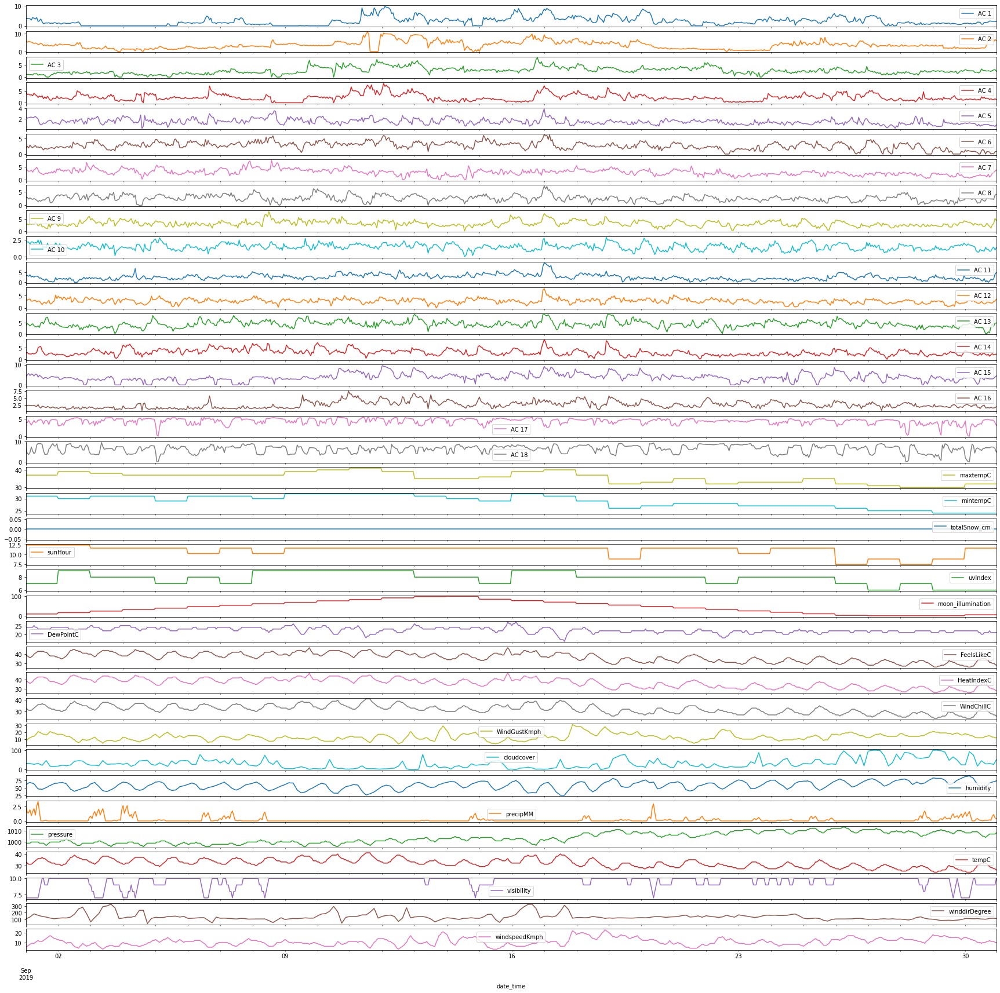

In [183]:
hourly_data.loc['2019-09-01':'2019-09-30'][column_name].plot(subplots=True,figsize=(30, 30))

In [184]:
temperature.columns


Index(['maxtempC', 'mintempC', 'totalSnow_cm', 'sunHour', 'uvIndex',
       'moon_illumination', 'moonrise', 'moonset', 'sunrise', 'sunset',
       'DewPointC', 'FeelsLikeC', 'HeatIndexC', 'WindChillC', 'WindGustKmph',
       'cloudcover', 'humidity', 'precipMM', 'pressure', 'tempC', 'visibility',
       'winddirDegree', 'windspeedKmph', 'city'],
      dtype='object')

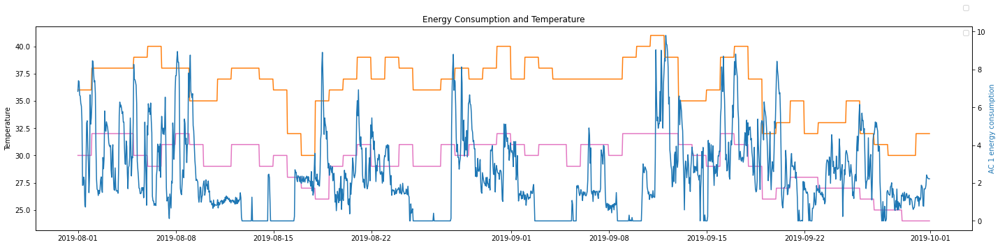

In [185]:
fig, ax1 = plt.subplots(figsize = (20,5))
ax1.plot(hourly_data.index, hourly_data.maxtempC, color = 'tab:orange')
ax1.plot(hourly_data.index, hourly_data.mintempC, color = 'tab:pink')
ax1.set_ylabel('Temperature')
ax1.legend()
ax2 = ax1.twinx()
ax2.plot(hourly_data.index,hourly_data['AC 1'],color = 'tab:blue')
ax2.set_ylabel('AC 1 energy consumption',color = 'tab:blue')
ax2.legend(bbox_to_anchor=(0.0, 1.02, 1.0, 0.102))
plt.title('Energy Consumption and Temperature')
fig.tight_layout()
plt.show()

In [186]:
ac_column=['AC 1', 'AC 2', 'AC 3', 'AC 4', 'AC 5', 'AC 6', 'AC 7', 'AC 8', 'AC 9',
       'AC 10', 'AC 11', 'AC 12', 'AC 13', 'AC 14', 'AC 15', 'AC 16', 'AC 17',
       'AC 18']

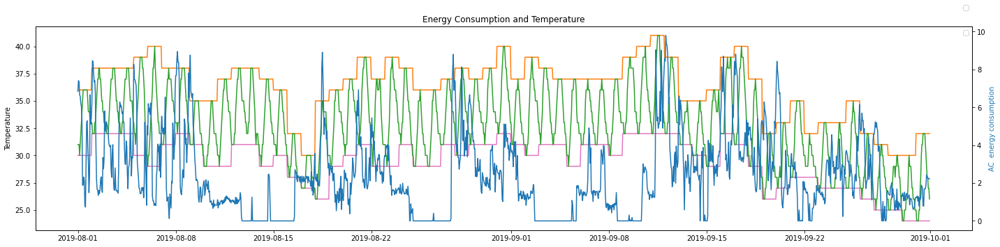

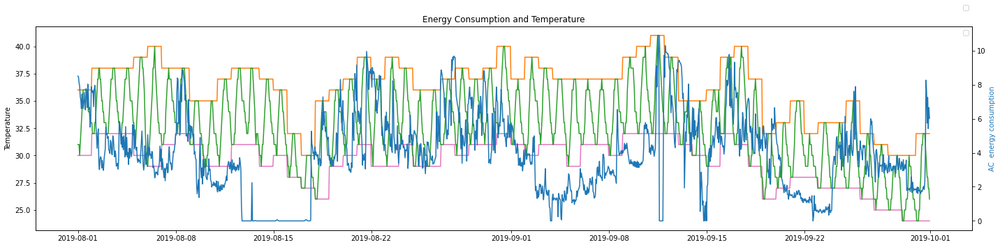

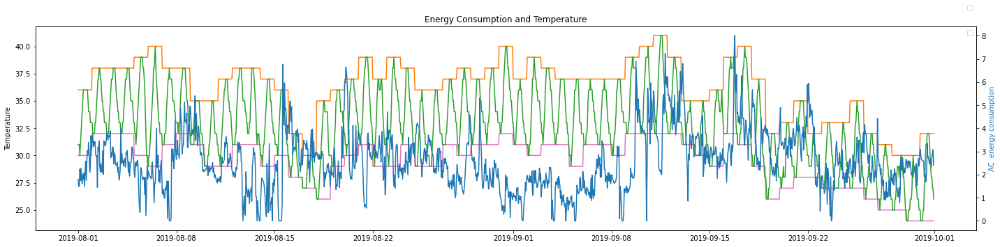

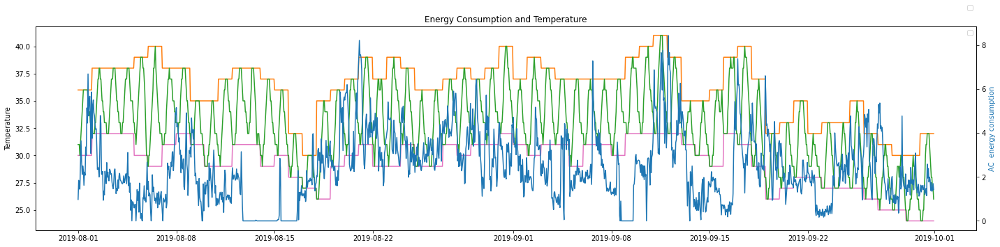

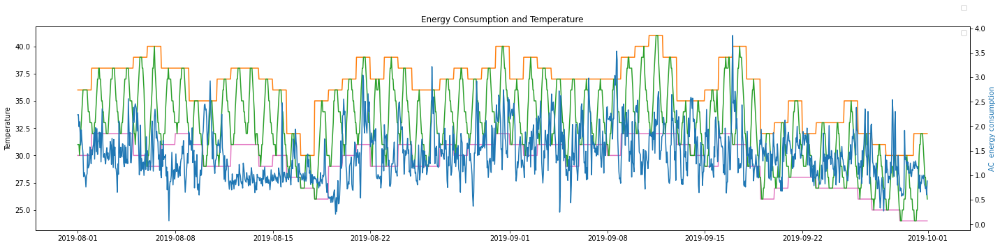

...

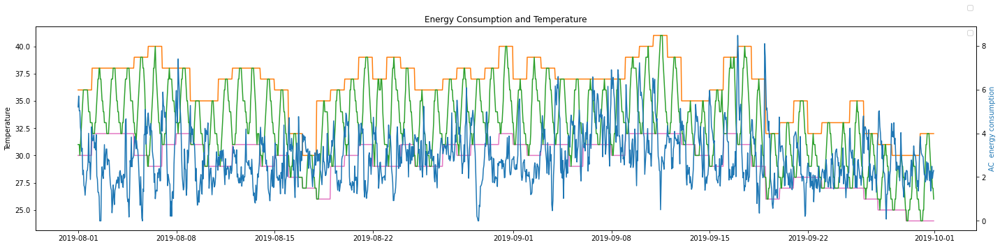

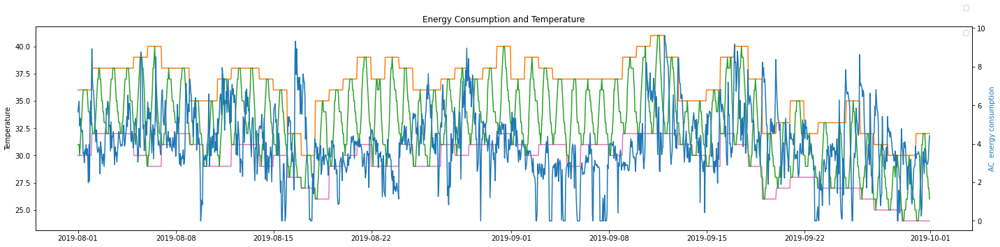

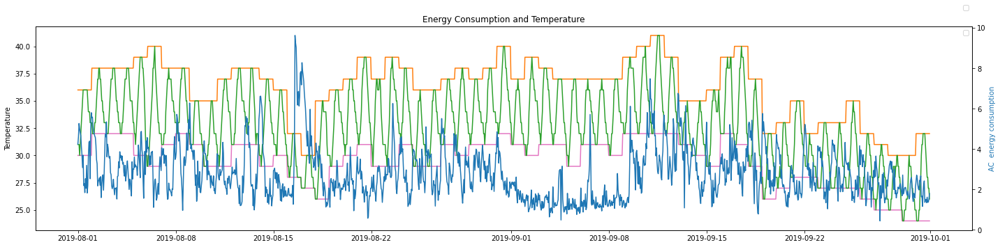

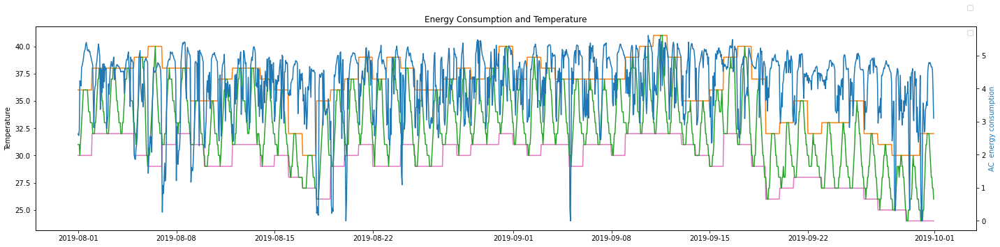

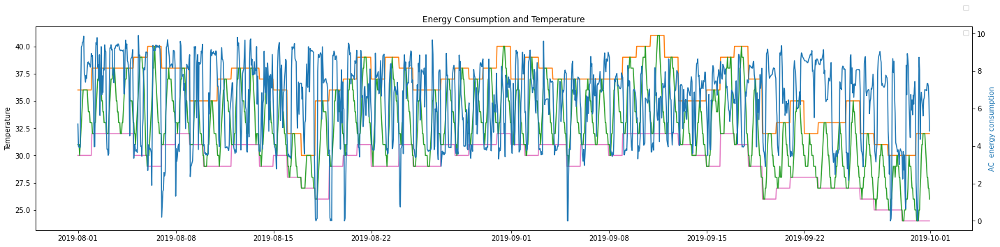

In [187]:
for value in ac_column:
    fig, ax1 = plt.subplots(figsize = (20,5))
    ax1.plot(hourly_data.index, hourly_data.maxtempC, color = 'tab:orange')
    ax1.plot(hourly_data.index, hourly_data.mintempC, color = 'tab:pink')
    ax1.plot(hourly_data.index, hourly_data.tempC, color = 'tab:green')

    ax1.set_ylabel('Temperature')
    ax1.legend()
    ax2 = ax1.twinx()
    ax2.plot(hourly_data.index,hourly_data[value],color = 'tab:blue')
    ax2.set_ylabel('AC  energy consumption',color = 'tab:blue')
    ax2.legend(bbox_to_anchor=(0.0, 1.02, 1.0, 0.102))
    plt.title('Energy Consumption and Temperature')
    fig.tight_layout()
    plt.show()

In [188]:
# temperature is greatly affecting the power consumption 

In [189]:
hourly_data.columns

Index(['AC 1', 'AC 2', 'AC 3', 'AC 4', 'AC 5', 'AC 6', 'AC 7', 'AC 8', 'AC 9',
       'AC 10', 'AC 11', 'AC 12', 'AC 13', 'AC 14', 'AC 15', 'AC 16', 'AC 17',
       'AC 18', 'maxtempC', 'mintempC', 'totalSnow_cm', 'sunHour', 'uvIndex',
       'moon_illumination', 'moonrise', 'moonset', 'sunrise', 'sunset',
       'DewPointC', 'FeelsLikeC', 'HeatIndexC', 'WindChillC', 'WindGustKmph',
       'cloudcover', 'humidity', 'precipMM', 'pressure', 'tempC', 'visibility',
       'winddirDegree', 'windspeedKmph', 'city'],
      dtype='object')

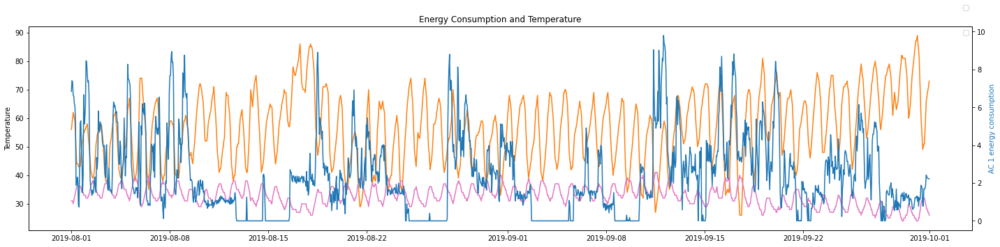

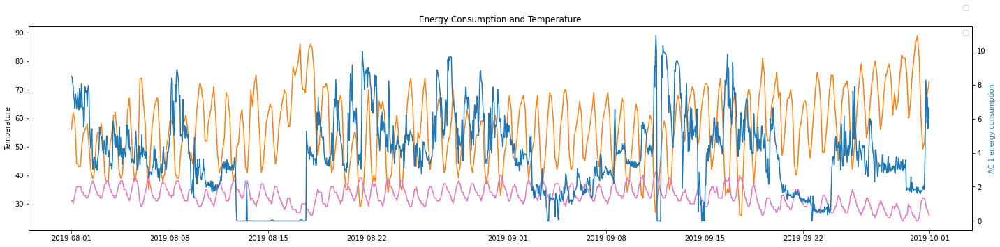

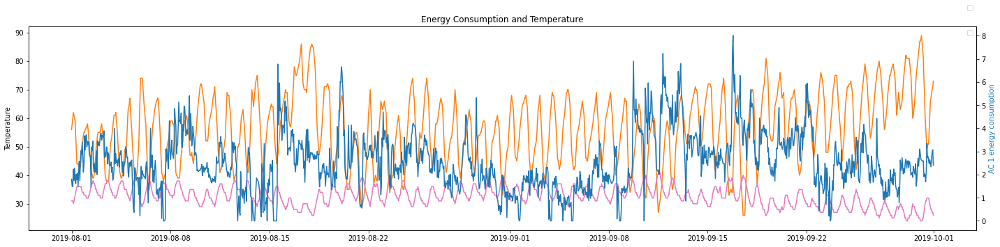

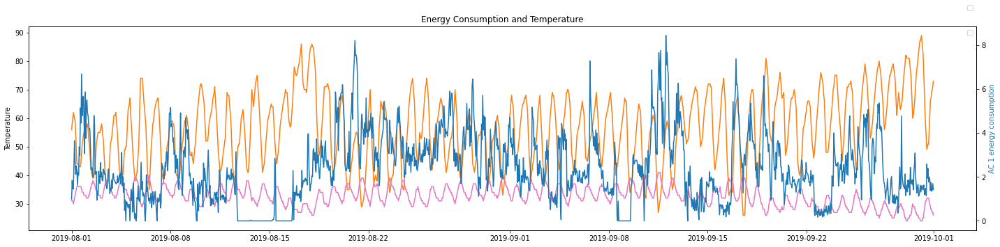

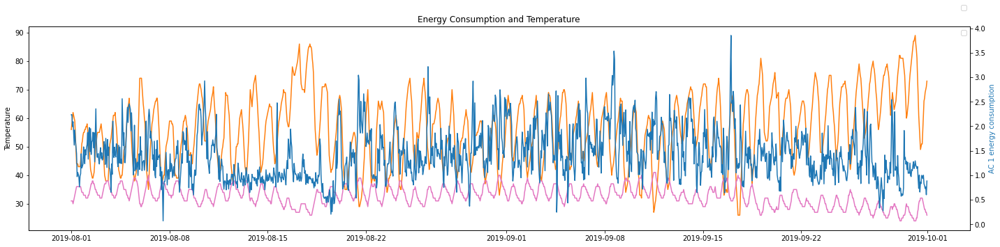

...

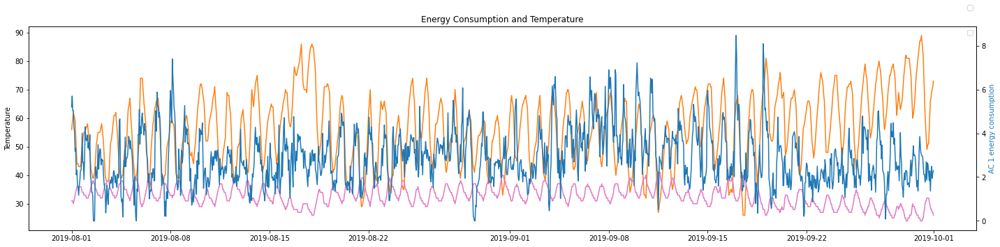

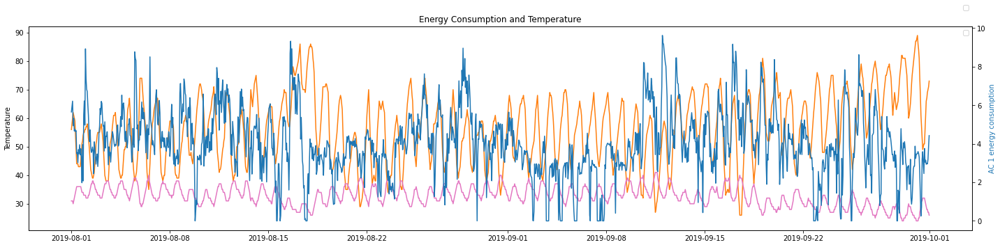

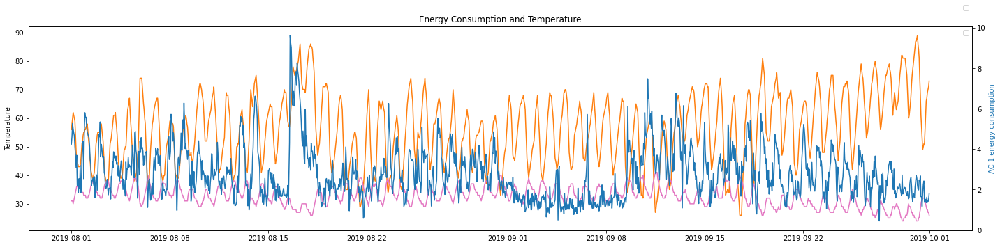

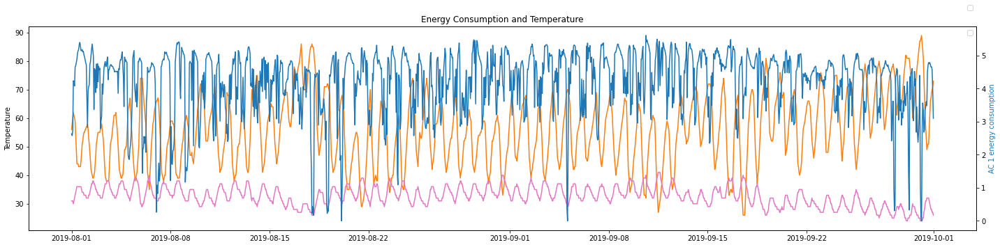

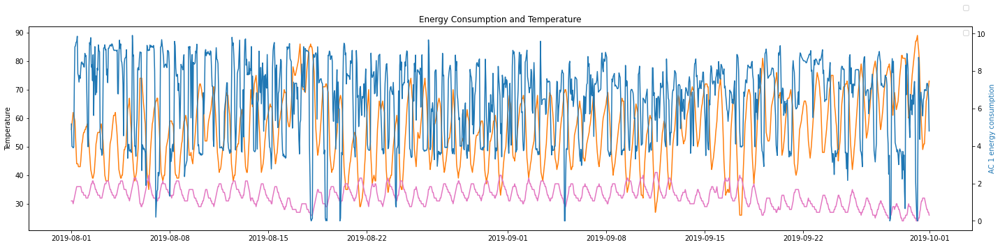

In [190]:
for value in ac_column:
    fig, ax1 = plt.subplots(figsize = (20,5))
    ax1.plot(hourly_data.index, hourly_data.humidity, color = 'tab:orange')
    ax1.plot(hourly_data.index, hourly_data.tempC, color = 'tab:pink')
    ax1.set_ylabel('Temperature')
    ax1.legend()
    ax2 = ax1.twinx()
    ax2.plot(hourly_data.index,hourly_data[value],color = 'tab:blue')
    ax2.set_ylabel('AC 1 energy consumption',color = 'tab:blue')
    ax2.legend(bbox_to_anchor=(0.0, 1.02, 1.0, 0.102))
    plt.title('Energy Consumption and Temperature')
    fig.tight_layout()
    plt.show()

In [191]:
# lets check other climate feature as well

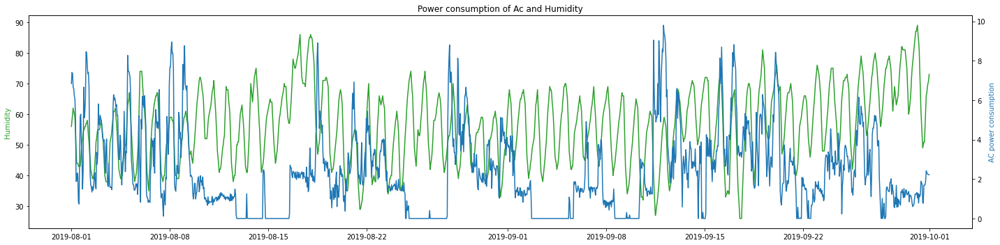

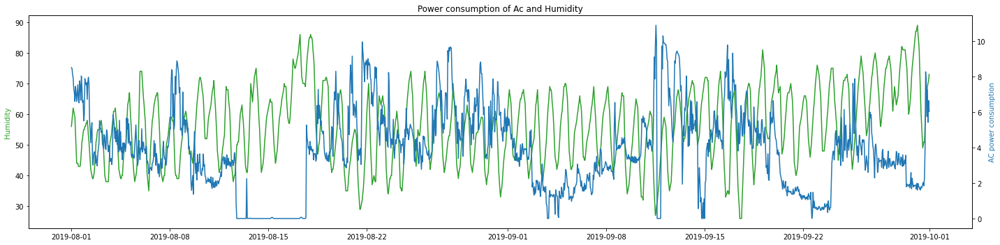

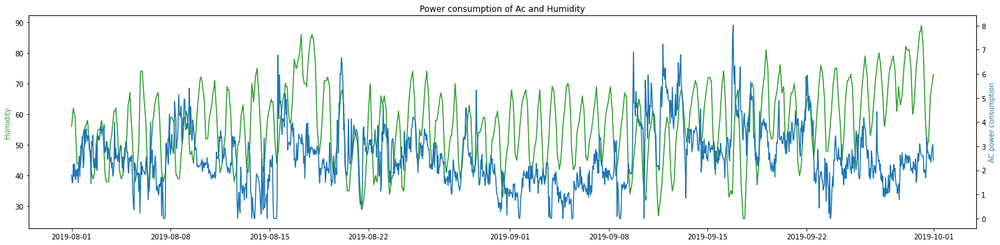

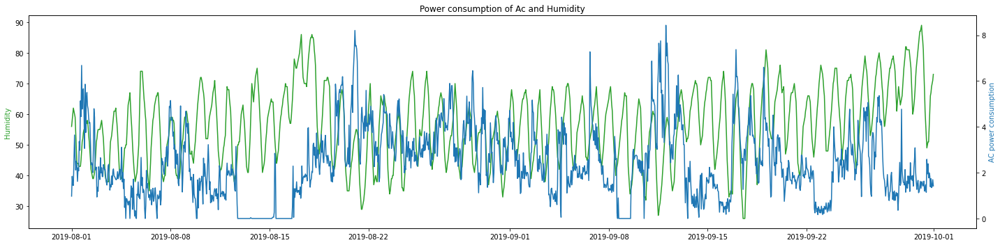

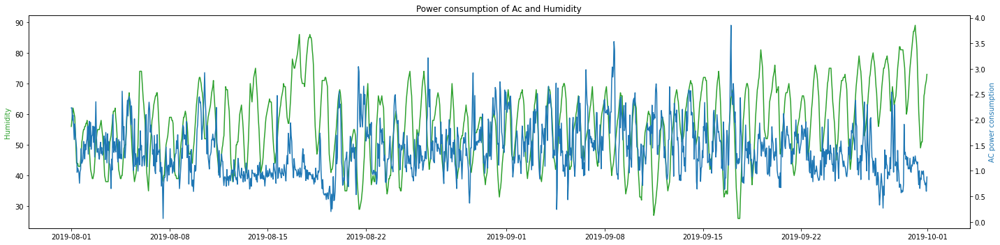

...

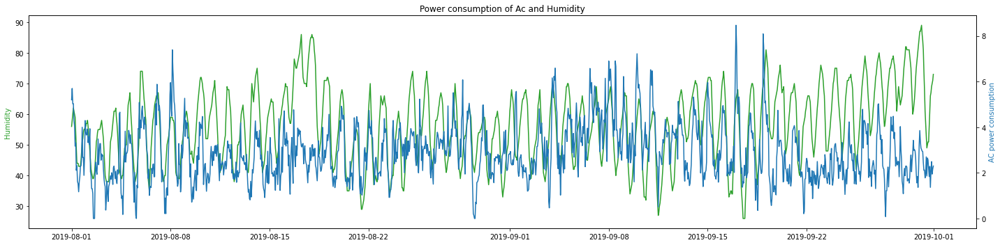

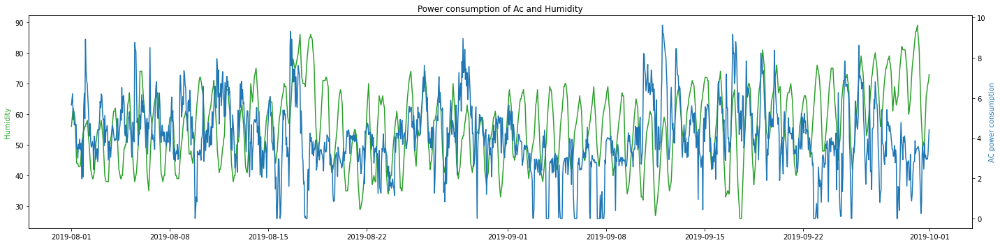

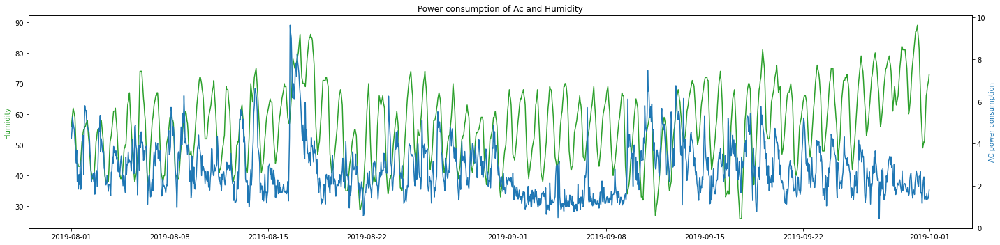

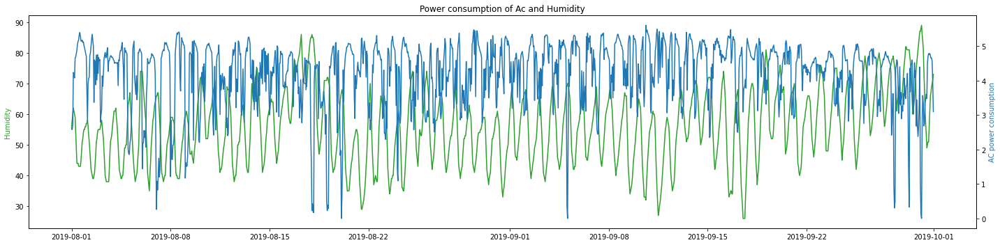

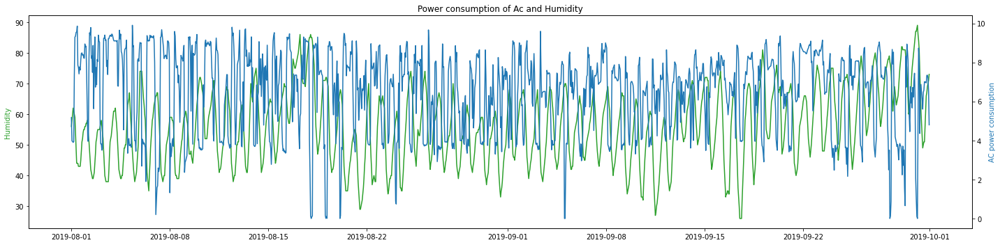

In [192]:
for value in ac_column:
    fig, ax1 = plt.subplots(figsize = (20,5))
    ax1.plot(hourly_data.index, hourly_data.humidity, color = 'tab:green')
    ax1.set_ylabel('Humidity ',color = 'tab:green')
    ax2 = ax1.twinx()
    ax2.plot(hourly_data.index,hourly_data[value],color = 'tab:blue')
    ax2.set_ylabel('AC power consumption',color = 'tab:blue')
    plt.title('Power consumption of Ac and Humidity')
    fig.tight_layout()
    plt.show()

In [193]:
## Humidity is also an important feature 

In [194]:
column_name

['AC 1',
 'AC 2',
 'AC 3',
 'AC 4',
 'AC 5',
 'AC 6',
 'AC 7',
 'AC 8',
 'AC 9',
 'AC 10',
 'AC 11',
 'AC 12',
 'AC 13',
 'AC 14',
 'AC 15',
 'AC 16',
 'AC 17',
 'AC 18',
 'maxtempC',
 'mintempC',
 'totalSnow_cm',
 'sunHour',
 'uvIndex',
 'moon_illumination',
 'moonrise',
 'moonset',
 'sunrise',
 'sunset',
 'DewPointC',
 'FeelsLikeC',
 'HeatIndexC',
 'WindChillC',
 'WindGustKmph',
 'cloudcover',
 'humidity',
 'precipMM',
 'pressure',
 'tempC',
 'visibility',
 'winddirDegree',
 'windspeedKmph',
 'city']

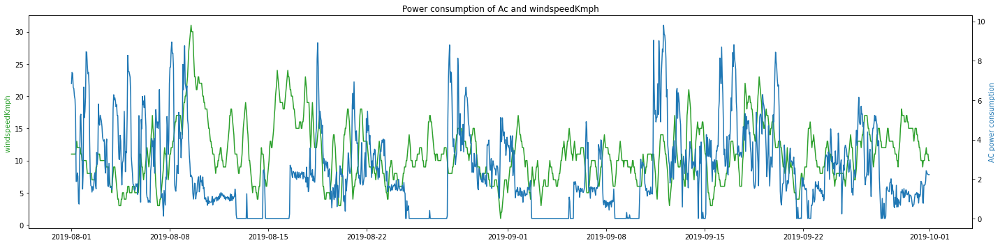

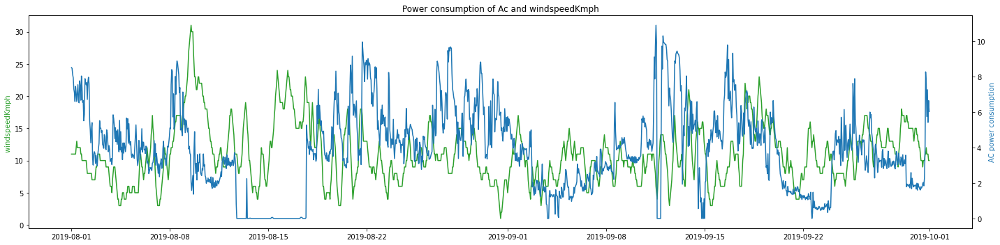

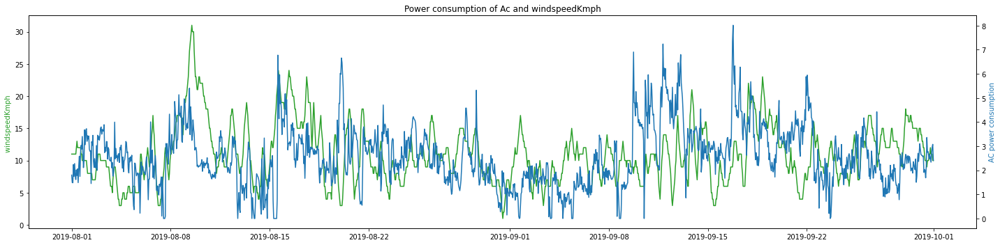

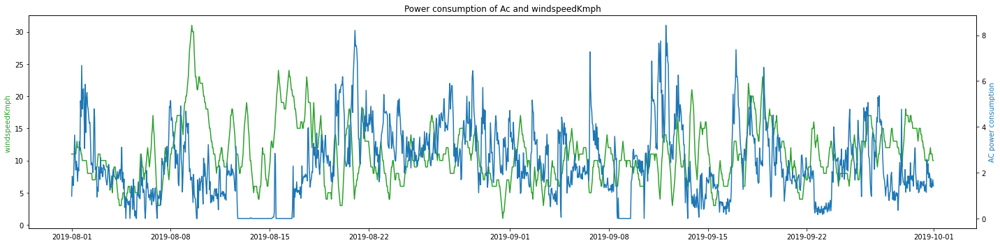

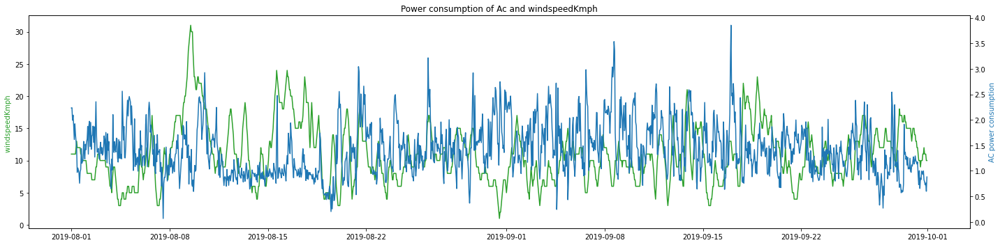

...

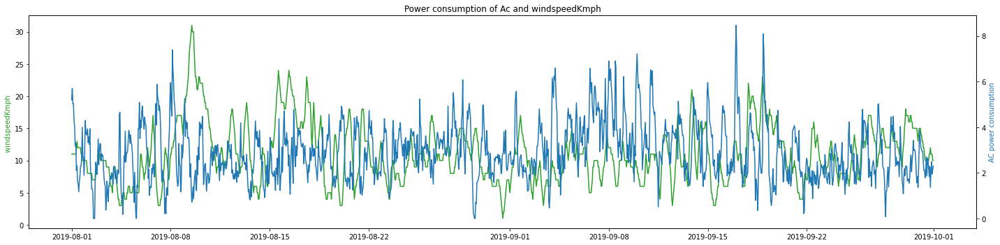

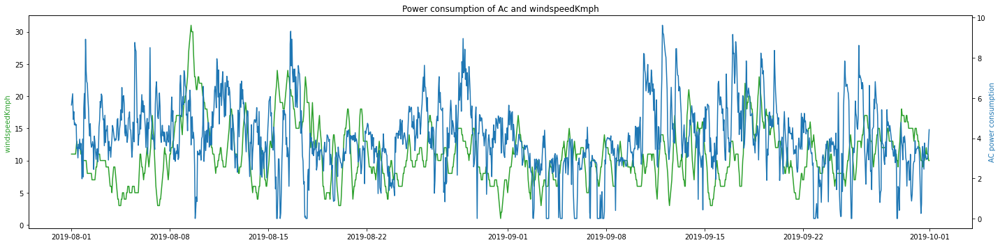

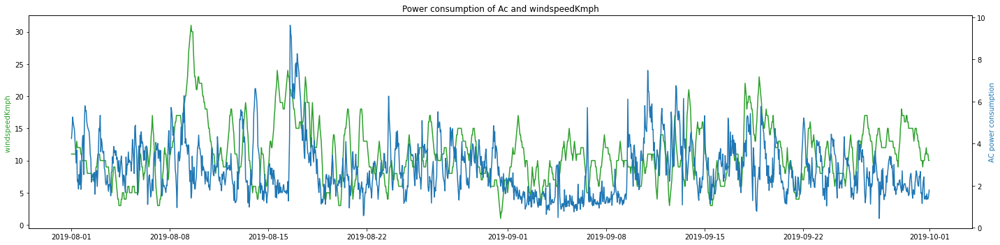

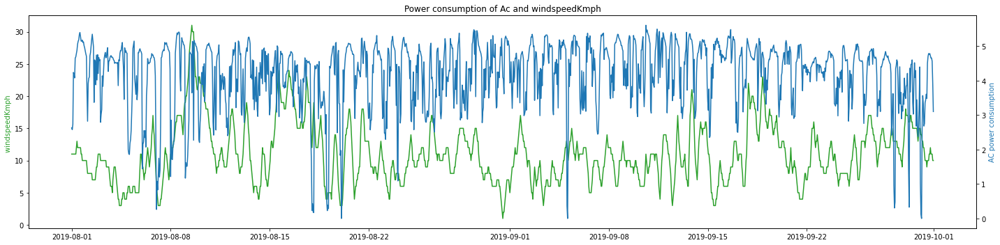

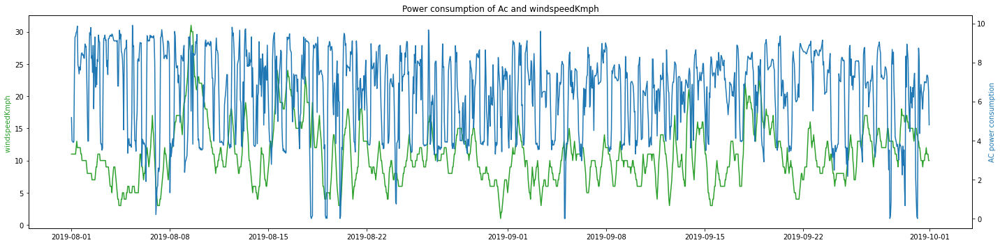

In [195]:
for value in ac_column:
    fig, ax1 = plt.subplots(figsize = (20,5))
    ax1.plot(hourly_data.index, hourly_data.windspeedKmph, color = 'tab:green')
    ax1.set_ylabel('windspeedKmph ',color = 'tab:green')
    ax2 = ax1.twinx()
    ax2.plot(hourly_data.index,hourly_data[value],color = 'tab:blue')
    ax2.set_ylabel('AC power consumption',color = 'tab:blue')
    plt.title('Power consumption of Ac and windspeedKmph')
    fig.tight_layout()
    plt.show()

In [196]:
## Wind speed is closely following the pattern of power consumption except ac 17 and 18

In [197]:
## check with cloud cover 

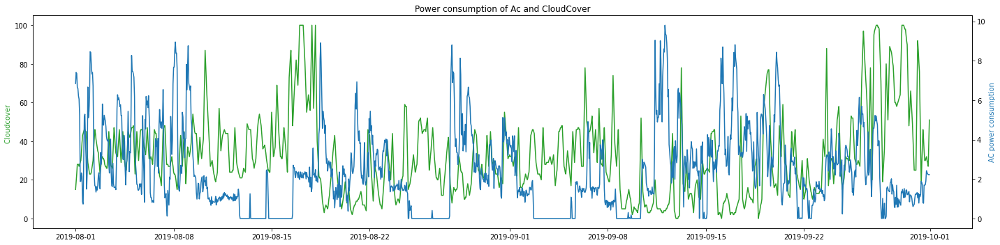

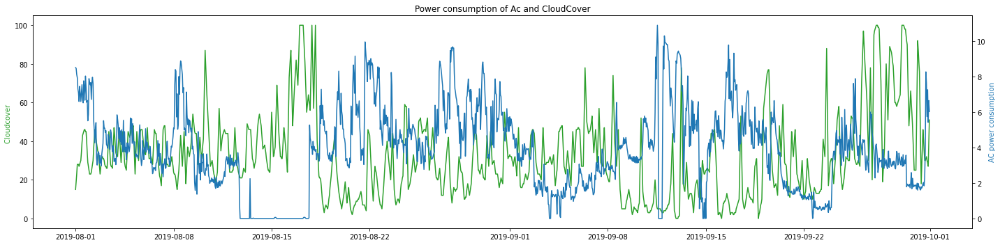

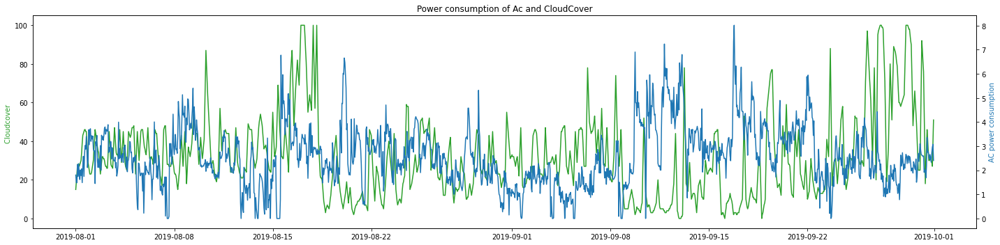

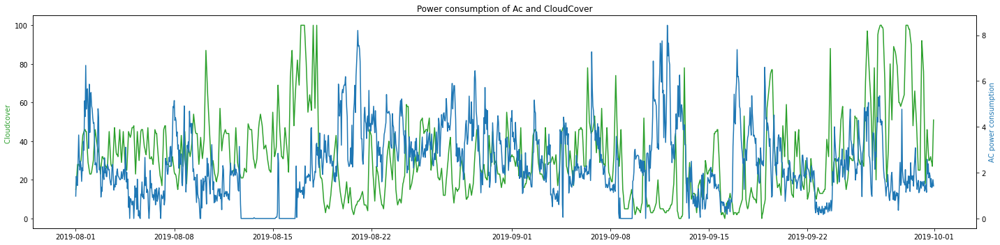

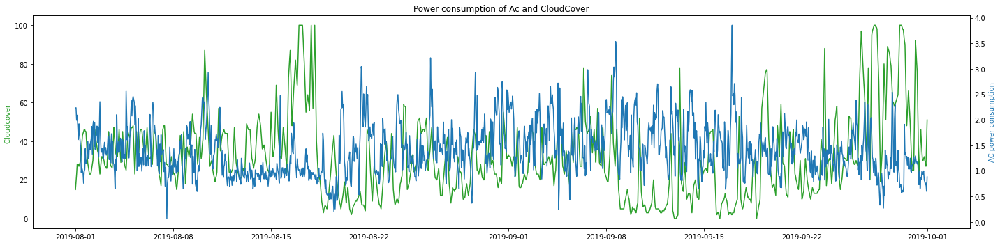

...

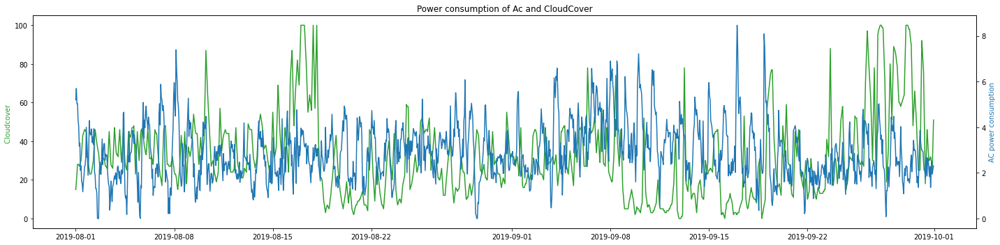

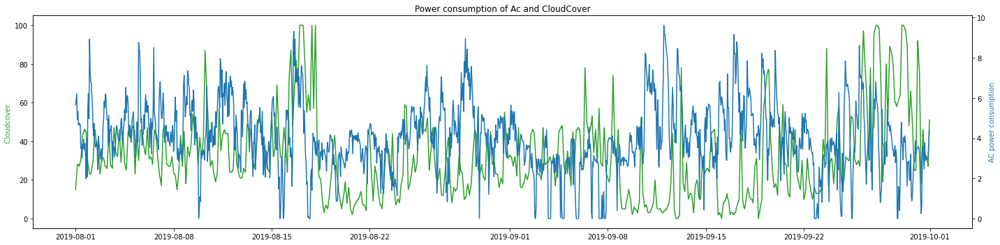

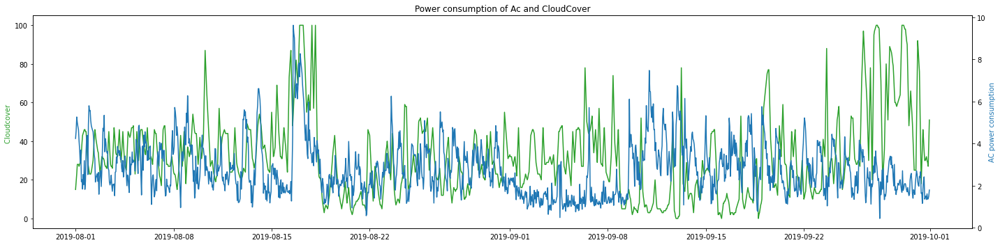

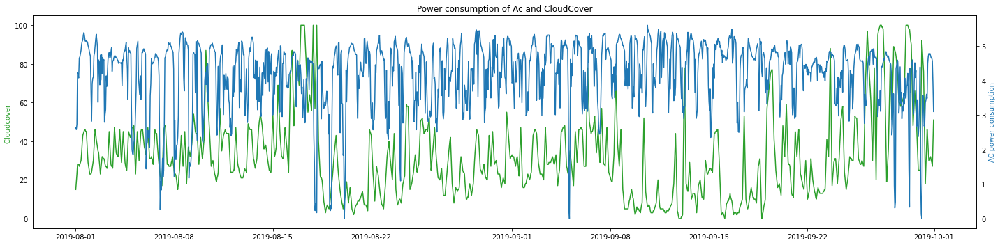

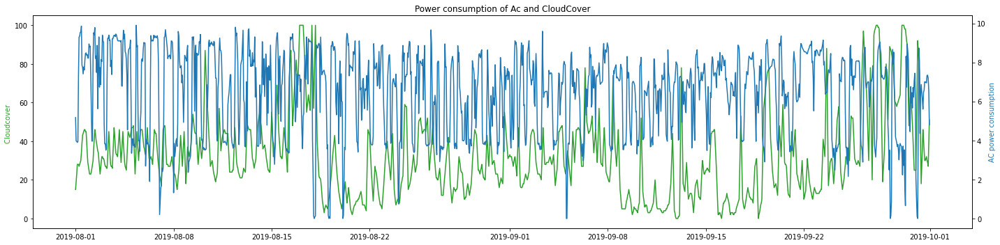

In [198]:
for value in ac_column:
    fig, ax1 = plt.subplots(figsize = (20,5))
    ax1.plot(hourly_data.index, hourly_data.cloudcover, color = 'tab:green')
    ax1.set_ylabel('Cloudcover ',color = 'tab:green')
    ax2 = ax1.twinx()
    ax2.plot(hourly_data.index,hourly_data[value],color = 'tab:blue')
    ax2.set_ylabel('AC power consumption',color = 'tab:blue')
    plt.title('Power consumption of Ac and CloudCover')
    fig.tight_layout()
    plt.show()

In [199]:
#The cloud cover value seems to be following the same pattern of AC energy consumption.



In [200]:
hourly_data.columns

Index(['AC 1', 'AC 2', 'AC 3', 'AC 4', 'AC 5', 'AC 6', 'AC 7', 'AC 8', 'AC 9',
       'AC 10', 'AC 11', 'AC 12', 'AC 13', 'AC 14', 'AC 15', 'AC 16', 'AC 17',
       'AC 18', 'maxtempC', 'mintempC', 'totalSnow_cm', 'sunHour', 'uvIndex',
       'moon_illumination', 'moonrise', 'moonset', 'sunrise', 'sunset',
       'DewPointC', 'FeelsLikeC', 'HeatIndexC', 'WindChillC', 'WindGustKmph',
       'cloudcover', 'humidity', 'precipMM', 'pressure', 'tempC', 'visibility',
       'winddirDegree', 'windspeedKmph', 'city'],
      dtype='object')

In [201]:
cor_matrix = hourly_data[['tempC','DewPointC', 'cloudcover', 'windspeedKmph' , 'humidity']].corr()
cor_matrix

,tempC,DewPointC,cloudcover,windspeedKmph,humidity
tempC,1.000000,-0.222993,-0.322231,-0.281013,-0.942871
DewPointC,-0.222993,1.000000,-0.074894,-0.048805,0.491072
cloudcover,-0.322231,-0.074894,1.000000,0.235575,0.278946
windspeedKmph,-0.281013,-0.048805,0.235575,1.000000,0.223436
humidity,-0.942871,0.491072,0.278946,0.223436,1.000000


In [202]:
#In next notebook we will try to build a forecasting Model with this temperature variables as well

In [203]:
# let me save my hourly csv data so we can use the same in the next notebook as well

In [204]:
hourly_data.to_csv('Power_consumption.csv',header=True,index=True)